In [7]:
#TODO: intercative plot easier to look at 
#TODO: Explore more data
#TODO: explore more weather dependencies

%load_ext autoreload
%autoreload 2

import warnings

import pandas as pd
from matplotlib import pyplot as plt
import matplotlib
import networkx as nx
import numpy as np
import pickle
from scipy.spatial import distance
import seaborn as sn

from src.util.bikes_map_plotter import map_plot

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:
#Load all the data related to the bikes shared mobility systems


centroid_trips_matrix = pd.read_pickle(
    open("src/env/bikes_data/centroid_trips_matrix5_40.pckl", "rb")
)
# _, _, _, _, _, _, centroid_coords = pickle.load(
#     open("src/env/bikes_data/training_data_5_40.pckl", "rb")
# )
centroid_coords = np.load("src/env/bikes_data/LouVelo_centroids_coords.npy")

all_trips_data = pd.read_csv(
    "src/env/bikes_data/dockless-vehicles-3_full.csv",
    usecols=lambda x: x not in ["TripID", "StartDate", "EndDate", "EndTime"],
)
# all_trips_data = pd.read_csv(
#     "src/env/bikes_data/all_trips_LouVelo_recent.csv",
#     usecols=lambda x: x not in ["TripID", "StartDate", "EndDate", "EndTime"],
# )

all_weather_data = pd.read_csv(
    "src/env/bikes_data/weather_data.csv",
    usecols=[
        "Year",
        "Month",
        "Day",
        "DayOfWeek",
        "Temp_Avg",
        "Precip",
        "Holiday",
    ],
)

In [9]:

hour_max = 24
# lattitudes = [38.15, 38.35]
# longitudes = [-85.9, -85.55]
lattitudes = [38.2, 38.28]
longitudes = [-85.8, -85.7]

#TODO: Weather of the year ???

period = (
    "Month > 0 & Month < 13 & Year == 19 & DayOfWeek >=0 and DayOfWeek <=8"
)
# period = (
#     "Month > 0 & Month < 13 & Year == 2019 & DayOfWeek >0 and DayOfWeek <8"
# )
area = (
    f"StartLatitude < {lattitudes[1]} & StartLatitude > {lattitudes[0]} & StartLongitude < {longitudes[1]} & StartLongitude > {longitudes[0]} "
    f"& EndLatitude < {lattitudes[1]} & EndLatitude > {lattitudes[0]} & EndLongitude < {longitudes[1]} & EndLongitude > {longitudes[0]} "
)
query = (
    "TripDuration < 60 & TripDuration > 0 & HourNum <= "
    + str(hour_max)
    + ""
    "&" + area + " & " + period
)
all_trips_data = all_trips_data.query(query)
all_weather_data = all_weather_data.query(
    "Month > 0 & Month < 13 & Year == 19 & DayOfWeek >=0 and DayOfWeek <=8" #+ "& Holiday == 0"
)

1. Analysis of centroids map

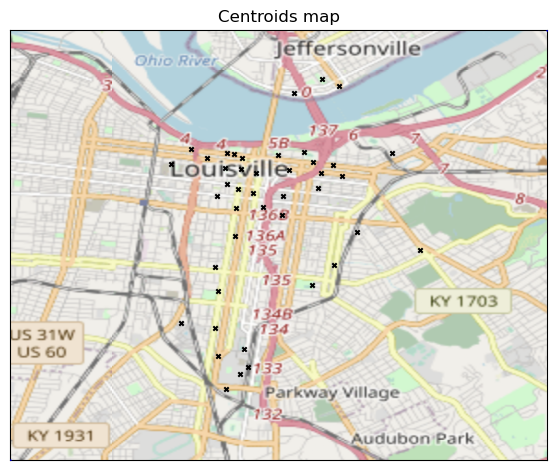

In [10]:
matplotlib.rcParams.update(matplotlib.rcParamsDefault)
fig = map_plot(lats=lattitudes, longs=longitudes, s=1, title="Centroids map", centroids=centroid_coords)
plt.show()

2. Demand evolution over time

In [11]:
print(all_trips_data[["Month", "Year", "Day"]].to_string())

        Month  Year  Day
65587       1    19    1
65588       1    19    1
65589       1    19    1
65590       1    19    1
65591       1    19    1
65592       1    19    1
65593       1    19    1
65594       1    19    1
65597       1    19    1
65598       1    19    1
65599       1    19    1
65600       1    19    1
65601       1    19    1
65602       1    19    1
65603       1    19    1
65604       1    19    1
65605       1    19    1
65606       1    19    1
65607       1    19    1
65608       1    19    1
65609       1    19    1
65610       1    19    1
65611       1    19    1
65612       1    19    1
65613       1    19    1
65614       1    19    1
65615       1    19    1
65616       1    19    1
65617       1    19    1
65618       1    19    1
65619       1    19    1
65620       1    19    1
65622       1    19    1
65624       1    19    1
65625       1    19    1
65626       1    19    1
65627       1    19    1
65628       1    19    1
65630       1    19    1


In [12]:
timeshift = 4 #hours
if not (24/timeshift).is_integer():
      raise ValueError("Please enter a timeshift that divides the whole day for simplicity")
num_timeshifts = 1000

time = 0
day = 2
month = 1
centroids_start = np.zeros((len(centroid_coords), num_timeshifts))
centroids_end = np.zeros((len(centroid_coords), num_timeshifts))
centroid_adj_start = np.zeros((len(centroid_coords), len(centroid_coords)))
centroid_adj_end = np.zeros((len(centroid_coords), len(centroid_coords)))
times = []
temp_avg = []
precip = []
holiday = []
for i in range(num_timeshifts):

    times.append((time, day, month))

    mask = (all_trips_data["Day"] == day) & (
        all_trips_data["Month"] == month
    )
    weather_mask = (all_weather_data["Day"] == day) & (
        all_weather_data["Month"] == month
    )
    next_index = np.where(mask)[0][-1]
    current_trips = all_trips_data[mask]
    weather = all_weather_data[weather_mask]
    
    temp_avg.append(weather.Temp_Avg.to_numpy()[0])
    precip.append(weather.Precip.to_numpy()[0])
    holiday.append(weather.Holiday.to_numpy()[0])

    # Keep only the trip at times we care:
    start_time = time
    end_time = time + timeshift

    time_mask = [
        float(time.replace(":", ".").split(".")[0]) >= start_time
        and float(time.replace(":", ".").split(".")[0]) <= end_time
        for time in current_trips["StartTime"].values
    ]

    current_trips = current_trips[time_mask]

    current_trips = current_trips.reset_index()  # make sure indexes pair with number of rows
    for index, trip in current_trips.iterrows():
        start_loc = np.array(
            [trip.StartLatitude, trip.StartLongitude]
        )
        # start_time = trip.iloc.StartTime

        distances = distance.cdist(
            start_loc.reshape(-1, 2), centroid_coords, metric="euclidean"
        )
        idx_start_centroid =  np.argmin(distances)

        end_loc = np.array(
        [trip.EndLatitude, trip.EndLongitude]
        )
        distances = distance.cdist(
            end_loc.reshape(-1, 2), centroid_coords, metric="euclidean"
        )
        idx_end_centroid = np.argmin(distances)

        centroids_start[idx_start_centroid, i] += 1
        centroids_end[idx_end_centroid, i] += 1

        #Compute adjacency
        centroid_adj_start[idx_start_centroid, idx_end_centroid] += 1
        centroid_adj_end[idx_end_centroid, idx_start_centroid] += 1

    time += timeshift
    if time >= 24:
        time = 0
        #Checker que ça marche bien !!!
        next_trip = all_trips_data.iloc[next_index+1]
        day = next_trip["Day"]
        month = next_trip["Month"]
        

Look at the most used depot centroids over time

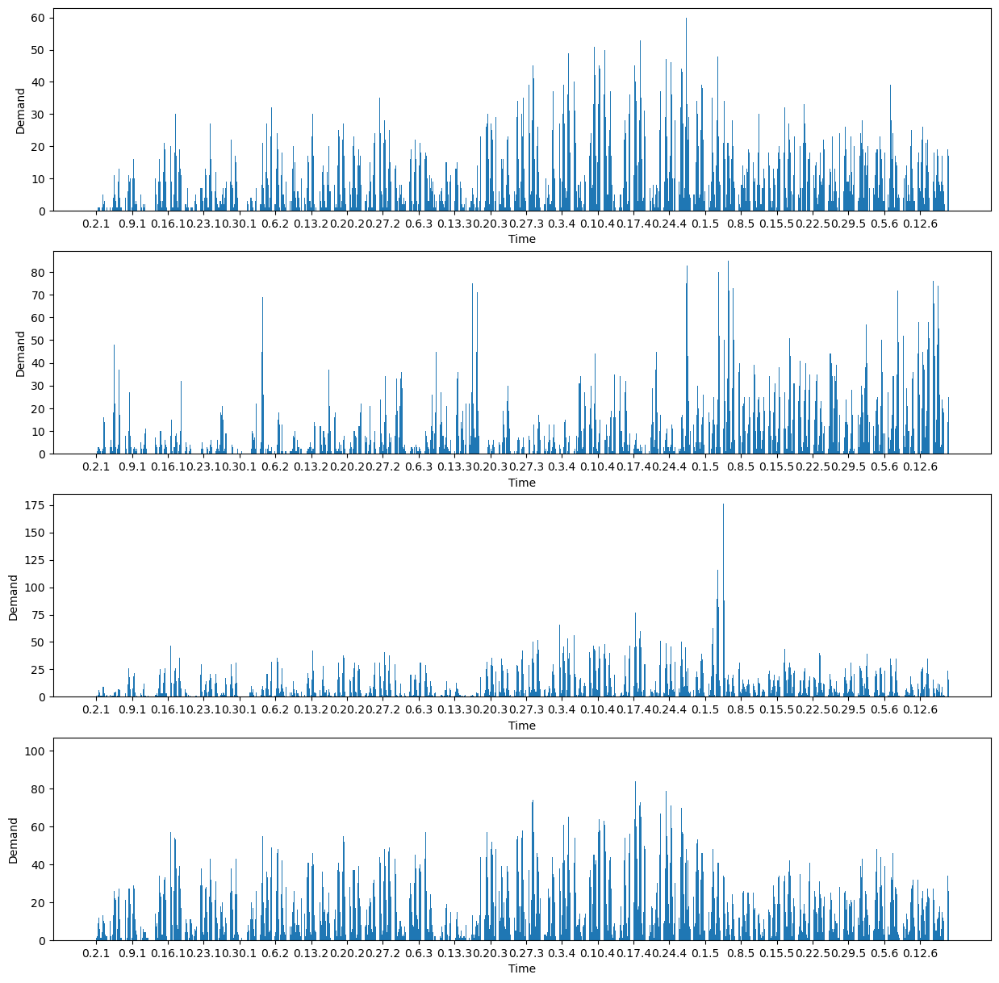

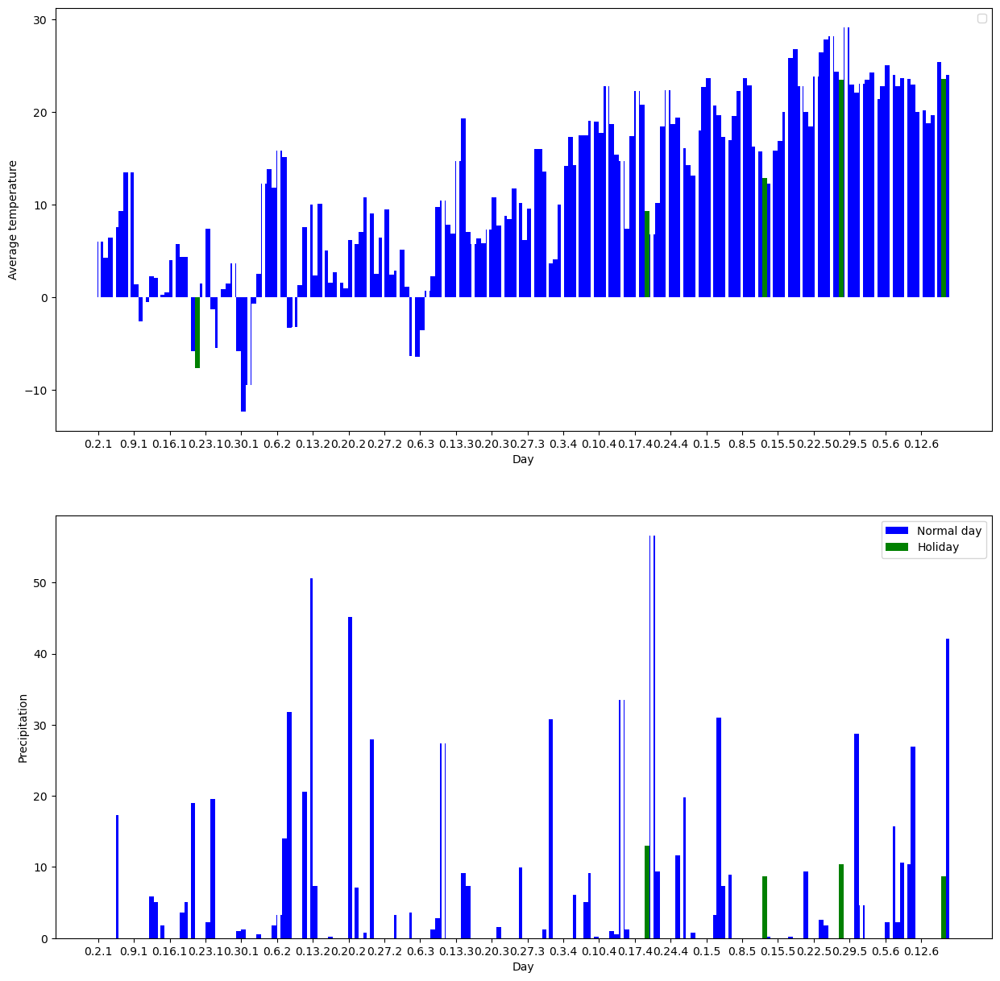

In [13]:
#Start centroid
num_best_centroids = 4
best_idx = np.argpartition(np.mean(centroids_start, axis=-1), -num_best_centroids)[-num_best_centroids:]
best_centroids_start = centroids_start[best_idx, :]

fig, axs = plt.subplots(num_best_centroids, 1, figsize=(15,15))
times_idx = [f"{time[0]}.{time[1]}.{time[2]}" for time in times]
num_hours_x_axis = 24*7
if not (num_hours_x_axis/timeshift).is_integer():
    warnings.warn(f"Better to give a multiple of timeshift {timeshift}")
x_axis_idx = num_hours_x_axis//timeshift

for i, centroid in enumerate(best_centroids_start):
    axs[i].bar(times_idx, centroid)
    axs[i].set_xlabel("Time")
    axs[i].set_ylabel("Demand")
    axs[i].set_xticks(times_idx[::x_axis_idx])

plt.show()

fig, axs = plt.subplots(2, 1, figsize=(15,15))

colors = []
labels = []
for holi in holiday: # keys are the names of the boys
    if holi:
        colors.append('green')
        labels.append('Holiday')
    else:
        colors.append('b')
        labels.append('Normal day')

axs[0].bar(times_idx, temp_avg,  color=colors, label=labels)
axs[0].set_xlabel("Day")
axs[0].set_ylabel("Average temperature")
axs[0].set_xticks(times_idx[::x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[0].legend(by_label.values(), by_label.keys(), loc="upper right")

axs[1].bar(times_idx, precip, color=colors, label=labels)
axs[1].set_xlabel("Day")
axs[1].set_ylabel("Precipitation")
axs[1].set_xticks(times_idx[::x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[1].legend(by_label.values(), by_label.keys(), loc="upper right")

plt.show()

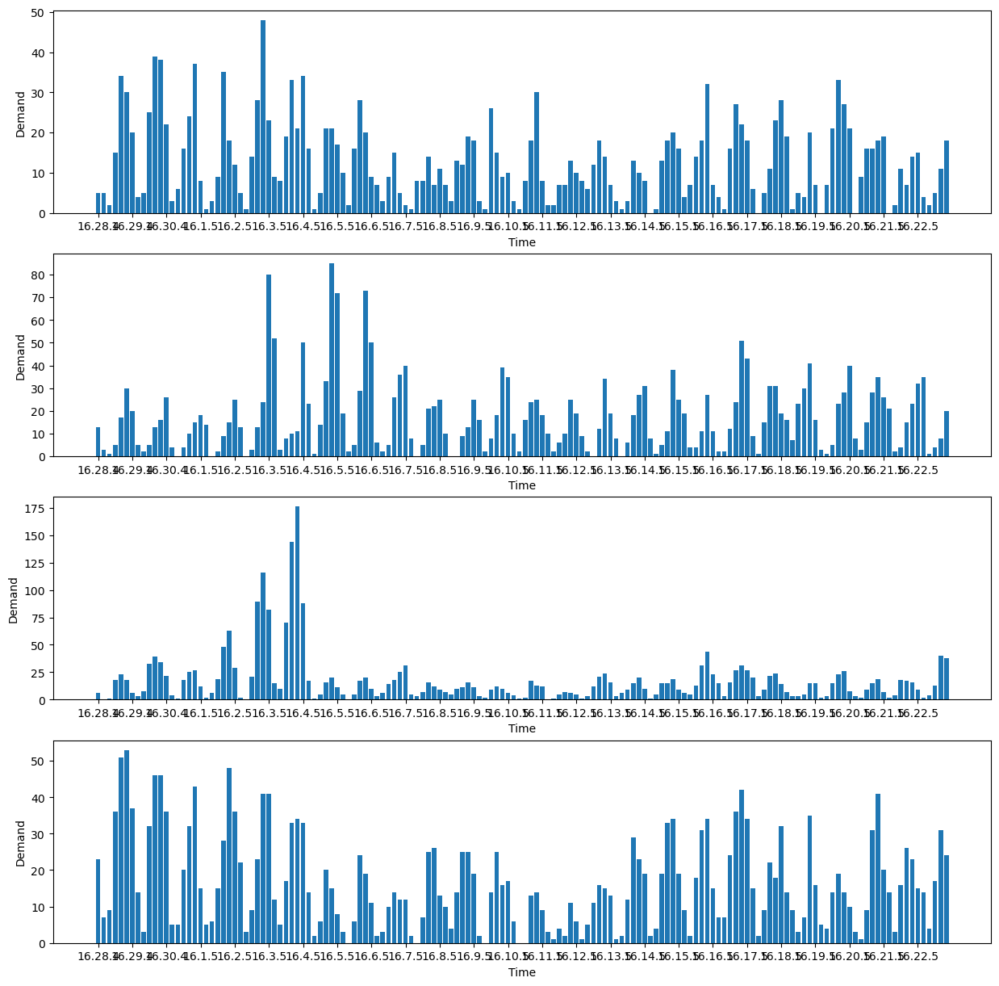

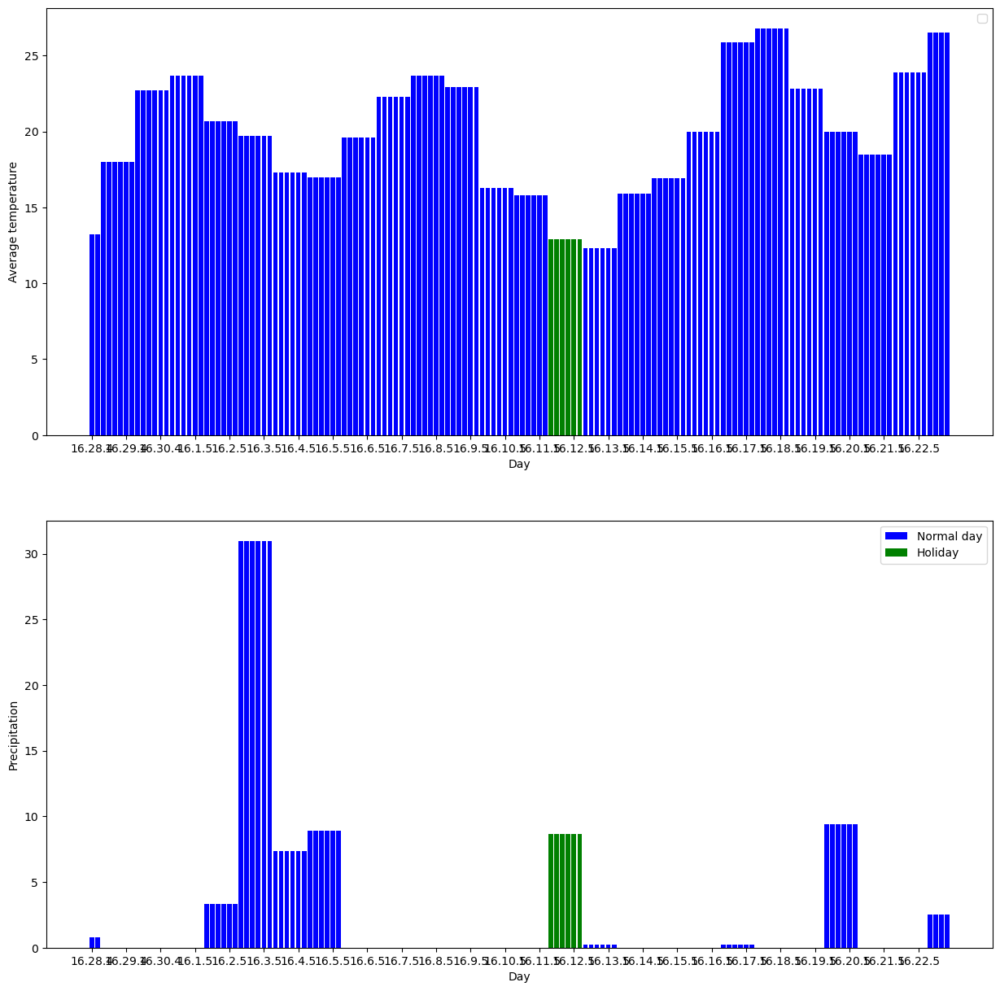

In [14]:
threshold = 700
sub_num_timeshifts = 150
sub_num_hours_x_axis = 24*1
if not (sub_num_hours_x_axis/timeshift).is_integer():
    warnings.warn(f"Better to give a multiple of timeshift {timeshift}")
sub_x_axis_idx = sub_num_hours_x_axis//timeshift

fig, axs = plt.subplots(num_best_centroids, 1, figsize=(15,15))
times_idx = [f"{time[0]}.{time[1]}.{time[2]}" for time in times]


for i, centroid in enumerate(best_centroids_start):
    axs[i].bar(times_idx[threshold:threshold+sub_num_timeshifts], centroid[threshold:threshold+sub_num_timeshifts])
    axs[i].set_xlabel("Time")
    axs[i].set_ylabel("Demand")
    axs[i].set_xticks(times_idx[threshold:threshold+sub_num_timeshifts][::sub_x_axis_idx])

plt.show()

fig, axs = plt.subplots(2, 1, figsize=(15,15))

colors = []
labels = []
for holi in holiday[threshold:threshold+sub_num_timeshifts]: # keys are the names of the boys
    if holi:
        colors.append('green')
        labels.append('Holiday')
    else:
        colors.append('b')
        labels.append('Normal day')

axs[0].bar(times_idx[threshold:threshold+sub_num_timeshifts], temp_avg[threshold:threshold+sub_num_timeshifts],  color=colors, label=labels)
axs[0].set_xlabel("Day")
axs[0].set_ylabel("Average temperature")
axs[0].set_xticks(times_idx[threshold:threshold+sub_num_timeshifts][::sub_x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[0].legend(by_label.values(), by_label.keys(), loc="upper right")

axs[1].bar(times_idx[threshold:threshold+sub_num_timeshifts], precip[threshold:threshold+sub_num_timeshifts], color=colors, label=labels)
axs[1].set_xlabel("Day")
axs[1].set_ylabel("Precipitation")
axs[1].set_xticks(times_idx[threshold:threshold+sub_num_timeshifts][::sub_x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[1].legend(by_label.values(), by_label.keys(), loc="upper right")

plt.show()

Look at the mean over all centroids

/tmp/ipykernel_12666/2473949772.py:4: RuntimeWarning: Mean of empty slice
  mean_centroid = np.nanmean(copy_centroids, axis=0)
/home/tvannier/anaconda3/envs/pdm_env/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


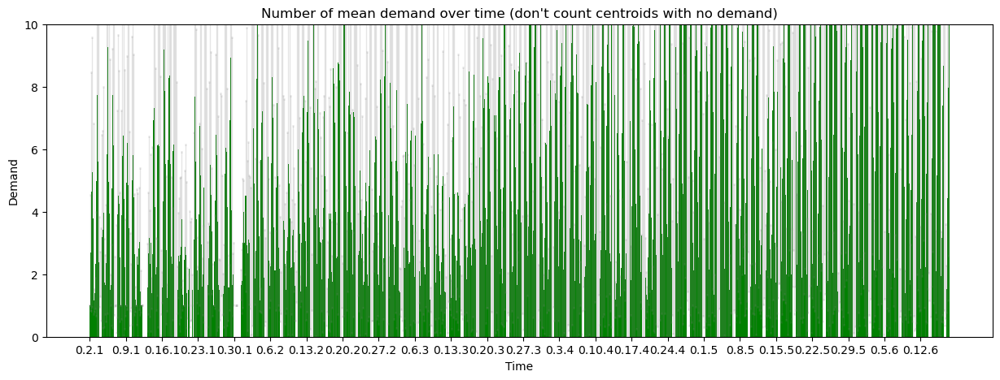

<Figure size 1500x500 with 0 Axes>

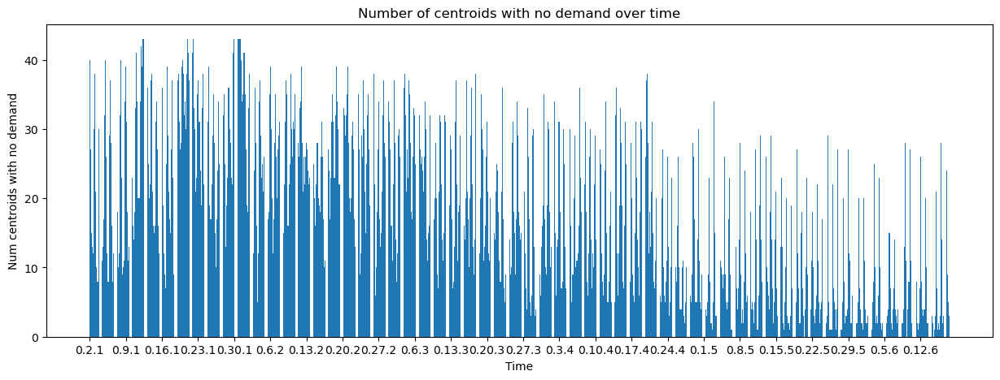

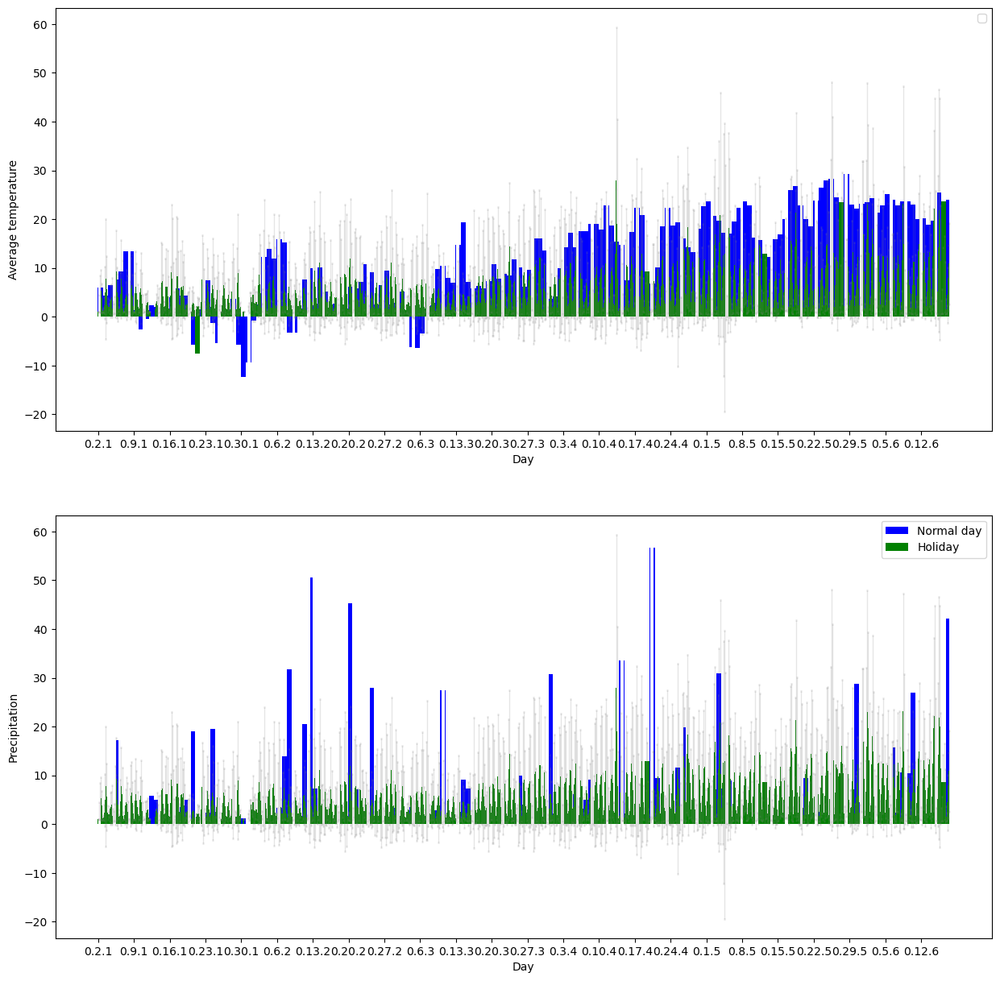

In [15]:
copy_centroids = centroids_start.copy()
copy_centroids[copy_centroids == 0] = np.nan

mean_centroid = np.nanmean(copy_centroids, axis=0)
std_centroid = np.nanstd(copy_centroids, axis=0)

plt.figure(figsize=(15, 5))
plt.bar(times_idx, mean_centroid, yerr=std_centroid, 
        color='green',
        error_kw=dict(ecolor='gray', lw=1, capsize=1, capthick=2, alpha=0.2))
plt.xlabel("Time")
plt.ylabel("Demand")
plt.ylim(0,10)
plt.title("Number of mean demand over time (don't count centroids with no demand)")
plt.xticks(times_idx[::x_axis_idx])
plt.figure(figsize=(15, 5))
plt.show()

zero_demands = np.sum(np.isnan(copy_centroids), axis=0)

plt.figure(figsize=(15, 5))
plt.bar(times_idx, zero_demands)
plt.xlabel("Time")
plt.ylabel("Num centroids with no demand")
plt.title("Number of centroids with no demand over time")
plt.xticks(times_idx[::x_axis_idx])
plt.show()

fig, axs = plt.subplots(2, 1, figsize=(15,15))

colors = []
labels = []
for holi in holiday: # keys are the names of the boys
    if holi:
        colors.append('green')
        labels.append('Holiday')
    else:
        colors.append('b')
        labels.append('Normal day')

axs[0].bar(times_idx, temp_avg,  color=colors, label=labels)
axs[0].bar(times_idx, mean_centroid, yerr=std_centroid, 
        color='green',
        error_kw=dict(ecolor='gray', lw=1, capsize=1, capthick=2, alpha=0.2))
axs[0].set_xlabel("Day")
axs[0].set_ylabel("Average temperature")
axs[0].set_xticks(times_idx[::x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[0].legend(by_label.values(), by_label.keys(), loc="upper right")

axs[1].bar(times_idx, precip, color=colors, label=labels)
axs[1].bar(times_idx, mean_centroid, yerr=std_centroid, 
        color='green',
        error_kw=dict(ecolor='gray', lw=1, capsize=1, capthick=2, alpha=0.2))
axs[1].set_xlabel("Day")
axs[1].set_ylabel("Precipitation")
axs[1].set_xticks(times_idx[::x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[1].legend(by_label.values(), by_label.keys(), loc="upper right")

plt.show()

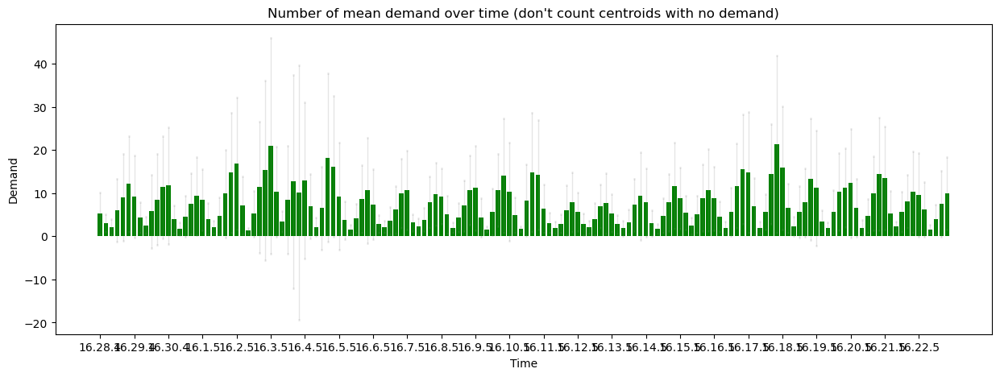

<Figure size 1500x500 with 0 Axes>

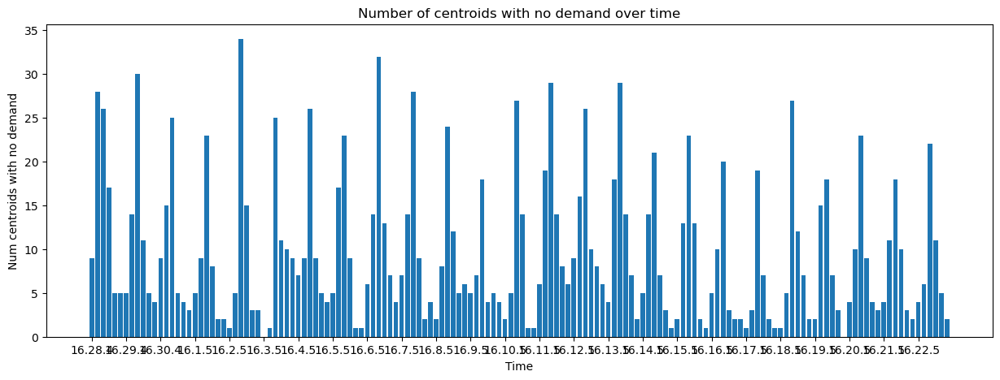

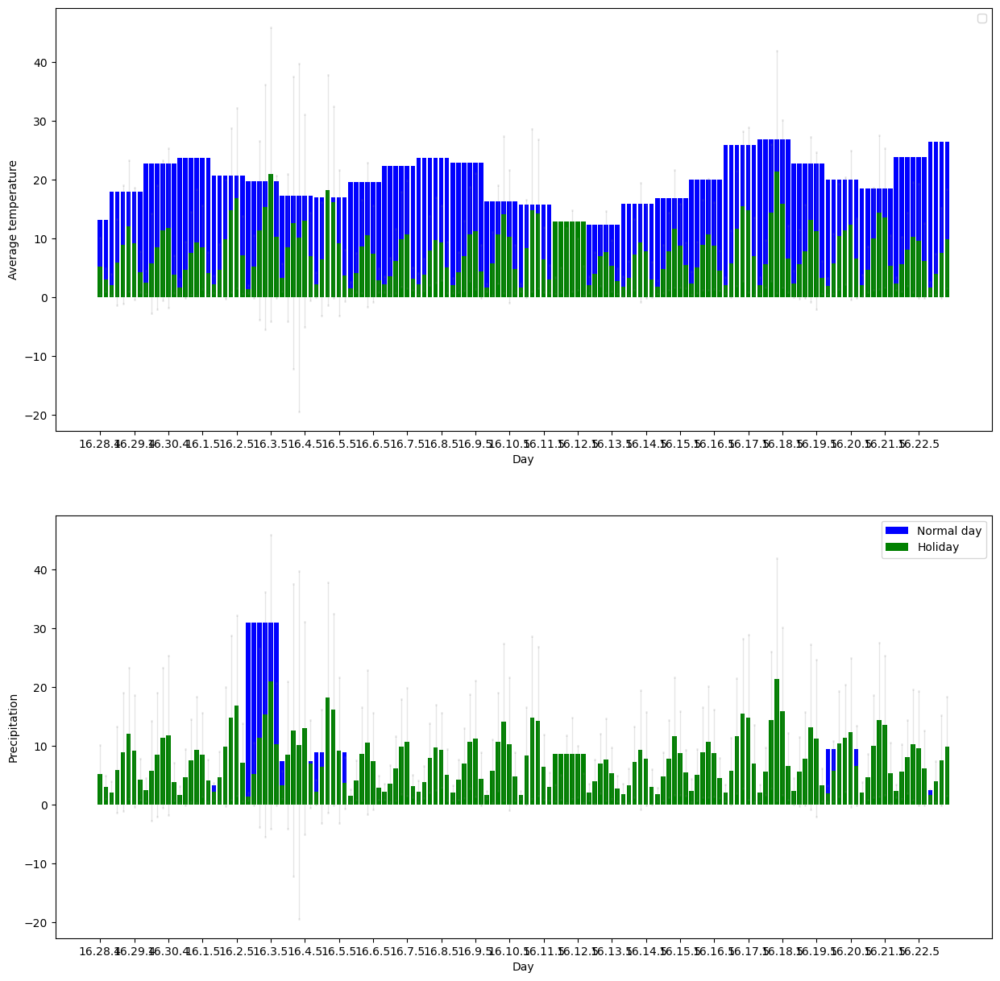

In [16]:
plt.figure(figsize=(15, 5))
plt.bar(times_idx[threshold:threshold+sub_num_timeshifts], mean_centroid[threshold:threshold+sub_num_timeshifts], yerr=std_centroid[threshold:threshold+sub_num_timeshifts], 
        color='green',
        error_kw=dict(ecolor='gray', lw=1, capsize=1, capthick=2, alpha=0.2))
plt.xlabel("Time")
plt.ylabel("Demand")
plt.title("Number of mean demand over time (don't count centroids with no demand)")
plt.xticks(times_idx[threshold:threshold+sub_num_timeshifts][::sub_x_axis_idx])
plt.figure(figsize=(15, 5))
plt.show()

zero_demands = np.sum(np.isnan(copy_centroids), axis=0)

plt.figure(figsize=(15, 5))
plt.bar(times_idx[threshold:threshold+sub_num_timeshifts], zero_demands[threshold:threshold+sub_num_timeshifts])
plt.xlabel("Time")
plt.ylabel("Num centroids with no demand")
plt.title("Number of centroids with no demand over time")
plt.xticks(times_idx[threshold:threshold+sub_num_timeshifts][::sub_x_axis_idx])
plt.show()

fig, axs = plt.subplots(2, 1, figsize=(15,15))

colors = []
labels = []
for holi in holiday[threshold:threshold+sub_num_timeshifts]: # keys are the names of the boys
    if holi:
        colors.append('green')
        labels.append('Holiday')
    else:
        colors.append('b')
        labels.append('Normal day')

axs[0].bar(times_idx[threshold:threshold+sub_num_timeshifts], temp_avg[threshold:threshold+sub_num_timeshifts],  color=colors, label=labels)
axs[0].bar(times_idx[threshold:threshold+sub_num_timeshifts], mean_centroid[threshold:threshold+sub_num_timeshifts], yerr=std_centroid[threshold:threshold+sub_num_timeshifts], 
        color='green',
        error_kw=dict(ecolor='gray', lw=1, capsize=1, capthick=2, alpha=0.2))
axs[0].set_xlabel("Day")
axs[0].set_ylabel("Average temperature")
axs[0].set_xticks(times_idx[threshold:threshold+sub_num_timeshifts][::sub_x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[0].legend(by_label.values(), by_label.keys(), loc="upper right")

axs[1].bar(times_idx[threshold:threshold+sub_num_timeshifts], precip[threshold:threshold+sub_num_timeshifts], color=colors, label=labels)
axs[1].bar(times_idx[threshold:threshold+sub_num_timeshifts], mean_centroid[threshold:threshold+sub_num_timeshifts], yerr=std_centroid[threshold:threshold+sub_num_timeshifts], 
        color='green',
        error_kw=dict(ecolor='gray', lw=1, capsize=1, capthick=2, alpha=0.2))
axs[1].set_xlabel("Day")
axs[1].set_ylabel("Precipitation")
axs[1].set_xticks(times_idx[threshold:threshold+sub_num_timeshifts][::sub_x_axis_idx])
handles, new_labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(new_labels, handles))
axs[1].legend(by_label.values(), by_label.keys(), loc="upper right")

plt.show()

2. Demand evolution in function of the weather

3. Met trips ratio in function of the number of bikes and trucks

In [17]:
from src.env.bikes import Rentals_Simulator

n_bikes_per_truck = 10
n_trucks = 10
walk_dist_max = 1
month = 8
day = 10
start_time = 8
end_time = 18
n_bikes = n_trucks*n_bikes_per_truck
num_centroids = len(centroid_coords)

simulator = Rentals_Simulator(all_trips_data, centroid_coords, walk_dist_max)

mask = (all_trips_data["Day"] == day) & (
    all_trips_data["Month"] == month
)
trips = all_trips_data[mask]

time_mask = [
    float(time.replace(":", ".").split(".")[0]) >= start_time
    and float(time.replace(":", ".").split(".")[0]) <= end_time
    for time in trips["StartTime"].values
]

trips = trips[time_mask]

Suppose the bikes are uniformly distributed

In [18]:
bikes_distr = np.zeros(num_centroids, dtype=int)
for i, bike in enumerate(range(n_bikes)):
    bikes_distr[i%num_centroids] += 1

print(f"Bikes distribution for {n_bikes} bikes")
print(bikes_distr)

(
new_x,
tot_num_trips,
num_met_trips,
too_far_from_centroid_trips,
trips_starting_coords,
met_trips_starting_coords,
too_far_from_centroid_trips_coords,
tot_demand_per_centroid,
met_trips_per_centroid,
adjacency_matrix
) = simulator.simulate_rentals(trips, bikes_distr)

relevant_trips = max(1, tot_num_trips - too_far_from_centroid_trips)
centroid_ratio = np.where(tot_demand_per_centroid != 0, met_trips_per_centroid / tot_demand_per_centroid, np.nan)
centroid_ratio = np.nanmean(centroid_ratio)

print("Relevant trips ratio: ", relevant_trips/tot_num_trips)
print("Met trips ratio: ", num_met_trips/relevant_trips)
print("Average met trips per centroid ratio: ", centroid_ratio)

Bikes distribution for 100 bikes
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2]
OKKKK
       StartTime  TripDuration  TripDistance  StartLatitude  StartLongitude  \
327572     08:00            55         2.650         38.257         -85.747   
327573     08:15             3         0.120         38.254         -85.757   
327574     08:15            51         4.180         38.256         -85.757   
327575     08:45            13         1.190         38.213         -85.750   
327576     08:00             6         0.880         38.235         -85.760   
...          ...           ...           ...            ...             ...   
329402     18:15            14         0.062         38.256         -85.753   
329403     18:30            14         0.000         38.257         -85.756   
329404     18:00            28         1.616         38.256         -85.753   
329405     18:45             8         0.000         38.255         -85.744   
329

In [22]:
walk_dist_max = 1

relevant_trips_ratio = []
trips_ratio = []
centroid_ratios = []
all_n_bikes = np.arange(1, 1000, 100)
for n_bikes in all_n_bikes:

    bikes_distr = np.zeros(num_centroids, dtype=int)
    for i, bike in enumerate(range(n_bikes)):
        bikes_distr[i%num_centroids] += 1

    print(f"Bikes distribution for {n_bikes} bikes:")
    print(bikes_distr)

    (
    new_x,
    tot_num_trips,
    num_met_trips,
    too_far_from_centroid_trips,
    trips_starting_coords,
    met_trips_starting_coords,
    too_far_from_centroid_trips_coords,
    tot_demand_per_centroid,
    met_trips_per_centroid,
    adjacency_matrix
    ) = simulator.simulate_rentals(trips, bikes_distr)

    relevant_trips = max(1, tot_num_trips - too_far_from_centroid_trips)
    centroid_ratio = np.where(tot_demand_per_centroid != 0, met_trips_per_centroid / tot_demand_per_centroid, np.nan)
    centroid_ratios.append(np.nanmean(centroid_ratio))
    relevant_trips_ratio.append(relevant_trips/tot_num_trips)
    trips_ratio.append(num_met_trips/relevant_trips)

Bikes distribution for 1 bikes:
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0]


Bikes distribution for 101 bikes:
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2]
Bikes distribution for 201 bikes:
[5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 4 4 4 4 4 4 4 4
 4 4 4 4 4 4]
Bikes distribution for 301 bikes:
[7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7
 7 7 7 7 7 7]
Bikes distribution for 401 bikes:
[10 10 10 10 10 10 10 10 10 10 10 10 10 10  9  9  9  9  9  9  9  9  9  9
  9  9  9  9  9  9  9  9  9  9  9  9  9  9  9  9  9  9  9]
Bikes distribution for 501 bikes:
[12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12
 12 12 12 12 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11]
Bikes distribution for 601 bikes:
[14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 13]
Bikes distribution for 701 bikes:
[17 17 17 17 17 17 17 17 17 17 17 17 17 16 16 16 16 16 16 16 16 16 16 16
 16 16 16 16 16 16 16 16 1

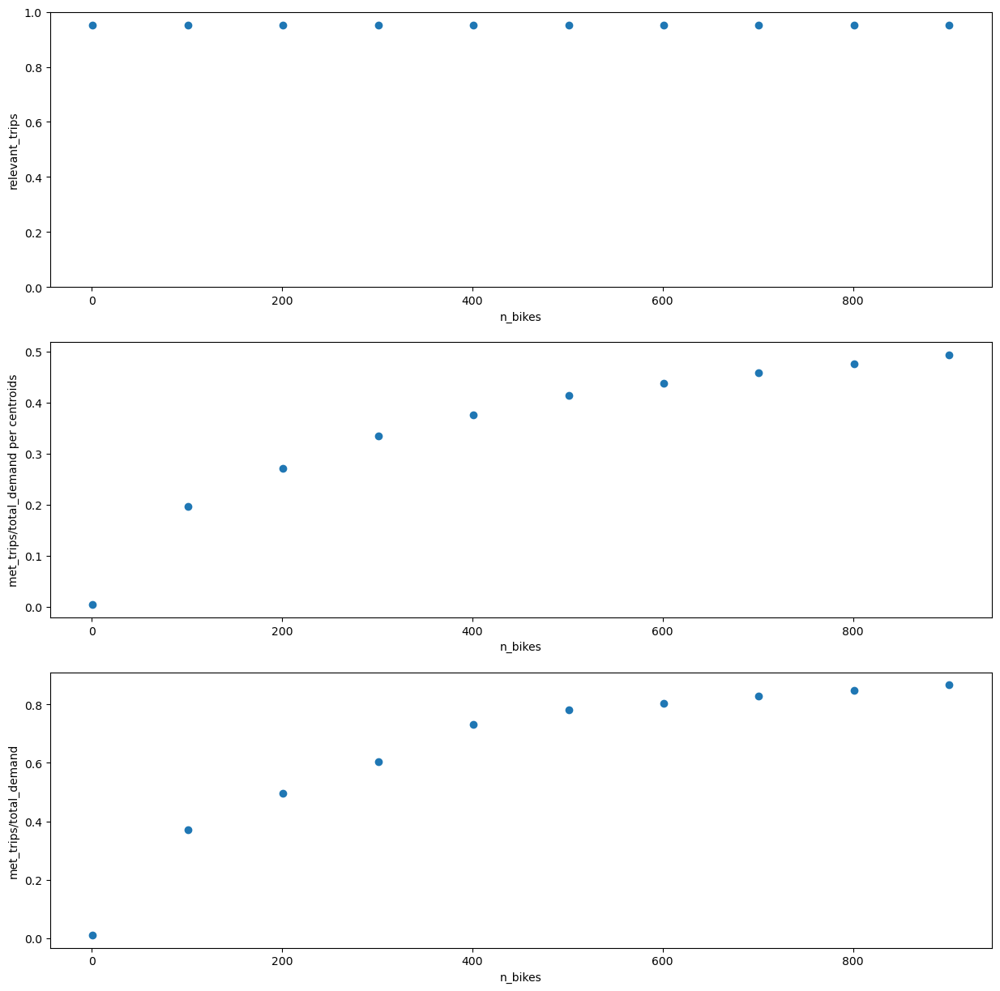

In [23]:

fig, axs = plt.subplots(3, 1, figsize=(15,15))

axs[0].plot(all_n_bikes, relevant_trips_ratio, 'o')
axs[0].set_xlabel('n_bikes')
axs[0].set_ylabel('relevant_trips')
axs[0].set_ylim(0, 1)

axs[1].plot(all_n_bikes, centroid_ratios, 'o')
axs[1].set_xlabel('n_bikes')
axs[1].set_ylabel('met_trips/total_demand per centroids')
axs[0].set_ylim(0, 1)

axs[2].plot(all_n_bikes, trips_ratio, 'o')
axs[2].set_xlabel('n_bikes')
axs[2].set_ylabel('met_trips/total_demand')
axs[0].set_ylim(0, 1)

plt.show()

Suppose the bikes are uniformly distributed among the "n_trucks" most used centroids depot  

In [24]:
#Warning: We need centroids_start to be accurate !! (See part 1 notebook)

num_best_centroids = 20

best_idx = np.argpartition(np.mean(centroids_start, axis=-1), -num_best_centroids)[-num_best_centroids:]
bikes_distr = np.zeros(num_centroids, dtype=int)
for i, bike in enumerate(range(n_bikes)):
    bikes_distr[best_idx[i%num_best_centroids]] += 1

print(f"Bikes distribution for {n_bikes} bikes:")
print(bikes_distr)

Bikes distribution for 901 bikes:
[45 45 45 46  0  0 45  0 45 45 45  0  0  0  0  0  0  0  0  0  0 45 45 45
 45  0 45  0 45 45  0  0  0 45 45 45 45  0 45  0  0  0  0]


In [25]:
walk_dist_max = 1

relevant_trips_ratio = []
trips_ratio = []
centroid_ratios = []
all_n_bikes = np.arange(1, 1000, 100)
for n_bikes in all_n_bikes:

    bikes_distr = np.zeros(num_centroids, dtype=int)
    for i, bike in enumerate(range(n_bikes)):
        bikes_distr[best_idx[i%num_best_centroids]] += 1

    print(f"Bikes distribution for {n_bikes} bikes:")
    print(bikes_distr)

    (
    new_x,
    tot_num_trips,
    num_met_trips,
    too_far_from_centroid_trips,
    trips_starting_coords,
    met_trips_starting_coords,
    too_far_from_centroid_trips_coords,
    tot_demand_per_centroid,
    met_trips_per_centroid,
    adjacency_matrix
    ) = simulator.simulate_rentals(trips, bikes_distr)

    relevant_trips = max(1, tot_num_trips - too_far_from_centroid_trips)
    centroid_ratio = np.where(tot_demand_per_centroid != 0, met_trips_per_centroid / tot_demand_per_centroid, np.nan)
    centroid_ratios.append(np.nanmean(centroid_ratio))
    relevant_trips_ratio.append(relevant_trips/tot_num_trips)
    trips_ratio.append(num_met_trips/relevant_trips)

Bikes distribution for 1 bikes:
[0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0]
Bikes distribution for 101 bikes:
[5 5 5 6 0 0 5 0 5 5 5 0 0 0 0 0 0 0 0 0 0 5 5 5 5 0 5 0 5 5 0 0 0 5 5 5 5
 0 5 0 0 0 0]
Bikes distribution for 201 bikes:
[10 10 10 11  0  0 10  0 10 10 10  0  0  0  0  0  0  0  0  0  0 10 10 10
 10  0 10  0 10 10  0  0  0 10 10 10 10  0 10  0  0  0  0]
Bikes distribution for 301 bikes:
[15 15 15 16  0  0 15  0 15 15 15  0  0  0  0  0  0  0  0  0  0 15 15 15
 15  0 15  0 15 15  0  0  0 15 15 15 15  0 15  0  0  0  0]
Bikes distribution for 401 bikes:
[20 20 20 21  0  0 20  0 20 20 20  0  0  0  0  0  0  0  0  0  0 20 20 20
 20  0 20  0 20 20  0  0  0 20 20 20 20  0 20  0  0  0  0]
Bikes distribution for 501 bikes:
[25 25 25 26  0  0 25  0 25 25 25  0  0  0  0  0  0  0  0  0  0 25 25 25
 25  0 25  0 25 25  0  0  0 25 25 25 25  0 25  0  0  0  0]
Bikes distribution for 601 bikes:
[30 30 30 31  0  0 30  0 30 30 30  0  0  0  0  0  0  0  0 

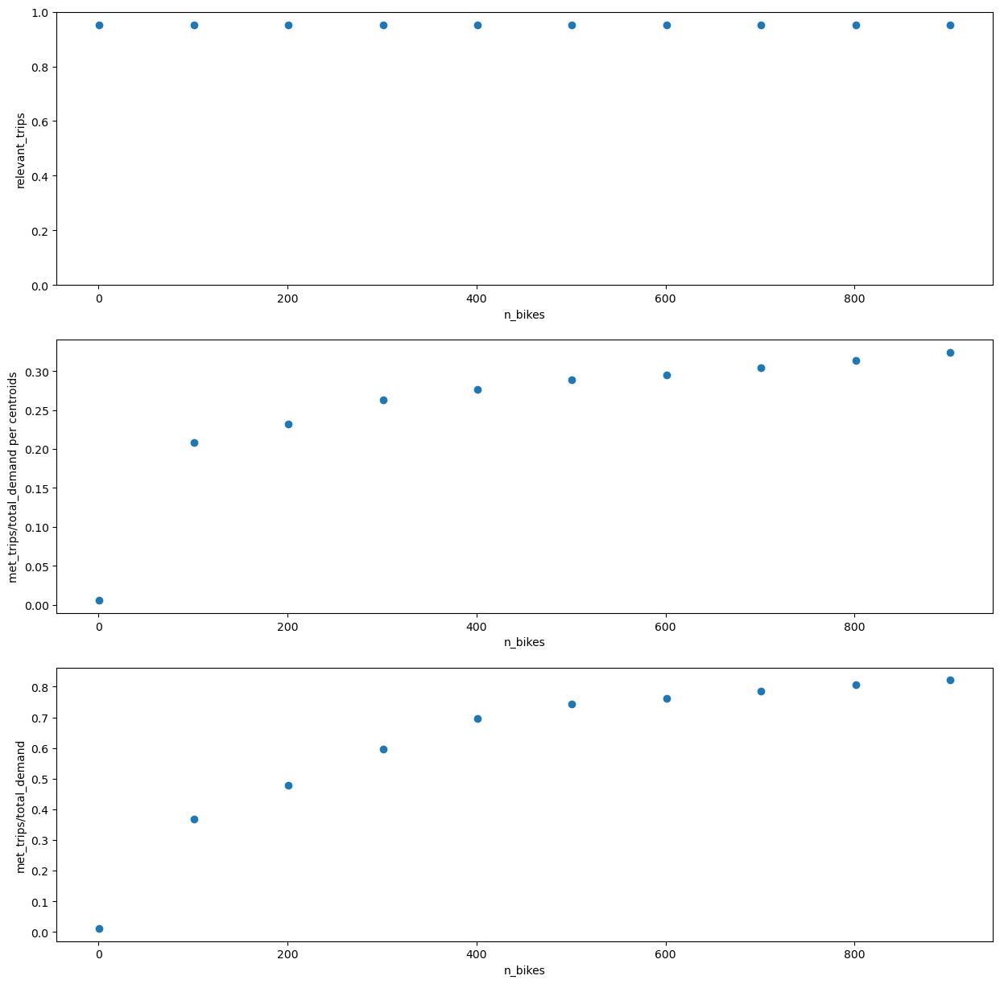

In [26]:

fig, axs = plt.subplots(3, 1, figsize=(15,15))

axs[0].plot(all_n_bikes, relevant_trips_ratio, 'o')
axs[0].set_xlabel('n_bikes')
axs[0].set_ylabel('relevant_trips')
axs[0].set_ylim(0, 1)

axs[1].plot(all_n_bikes, centroid_ratios, 'o')
axs[1].set_xlabel('n_bikes')
axs[1].set_ylabel('met_trips/total_demand per centroids')
axs[0].set_ylim(0, 1)

axs[2].plot(all_n_bikes, trips_ratio, 'o')
axs[2].set_xlabel('n_bikes')
axs[2].set_ylabel('met_trips/total_demand')
axs[0].set_ylim(0, 1)

plt.show()

4. Explore factors

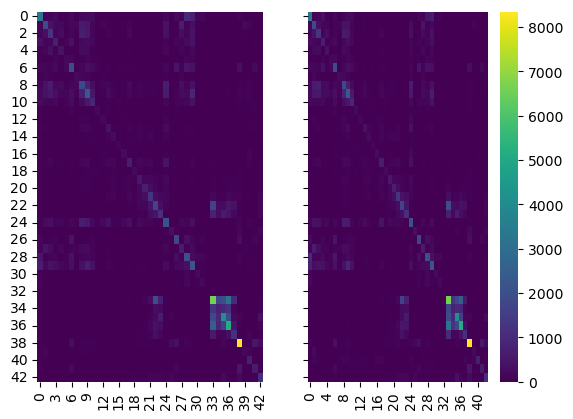

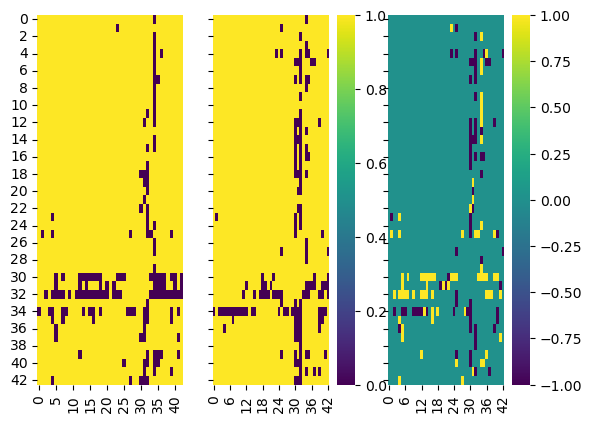

In [27]:
fig, axs = plt.subplots(1,2, sharey=True)


h1 = sn.heatmap(pd.DataFrame(centroid_adj_start), cmap="viridis", ax=axs[0], cbar=False, vmin=0)
h2 = sn.heatmap(pd.DataFrame(centroid_adj_end), cmap="viridis", ax=axs[1], vmin=0)

plt.show()

fig, axs = plt.subplots(1,3, sharey=True)

centroid_adj_end_binary = centroid_adj_end.copy()
centroid_adj_start_binary = centroid_adj_start.copy()

centroid_adj_end_binary[centroid_adj_end_binary!=0] = 1
centroid_adj_start_binary[centroid_adj_start_binary !=0] = 1

centroid_adj_diff = centroid_adj_end_binary - centroid_adj_start_binary

h1 = sn.heatmap(pd.DataFrame(centroid_adj_start_binary), cmap="viridis", ax=axs[0], cbar=False, vmin=0)
h2 = sn.heatmap(pd.DataFrame(centroid_adj_end_binary), cmap="viridis", ax=axs[1], vmin=0)
h3 = sn.heatmap(pd.DataFrame(centroid_adj_diff), cmap="viridis", ax=axs[2], vmin=-1)

plt.show()

In [28]:
in_degree = np.zeros(num_centroids)
out_degree = np.zeros(num_centroids)
not_same = np.zeros(num_centroids)

for i, (in_bikes, out_bikes, diff) in enumerate(zip(centroid_adj_end, centroid_adj_start, centroid_adj_diff)):
    in_degree[i] = np.count_nonzero(in_bikes)
    out_degree[i] = np.count_nonzero(out_bikes)
    not_same[i] = np.count_nonzero(diff)

print("How many parents each centroid has")
print(in_degree)
print("How many children each centroid has")
print(out_degree)
print("Among them how many are exclusively a child or a parent")
print(not_same)

How many parents each centroid has
[42. 42. 42. 42. 37. 38. 42. 39. 42. 42. 43. 42. 39. 40. 40. 40. 39. 41.
 39. 42. 41. 43. 41. 40. 41. 41. 42. 40. 42. 43. 39. 32. 27. 40. 19. 37.
 38. 40. 42. 37. 40. 39. 40.]
How many children each centroid has
[42. 42. 42. 42. 41. 42. 42. 41. 42. 42. 42. 41. 41. 43. 42. 41. 43. 42.
 40. 41. 42. 42. 41. 41. 41. 37. 42. 42. 43. 42. 23. 31. 14. 42. 27. 37.
 41. 39. 43. 37. 38. 40. 38.]
Among them how many are exclusively a child or a parent
[ 0.  2.  2.  0.  6.  6.  2.  2.  0.  2.  1.  1.  4.  3.  4.  1.  4.  1.
  1.  1.  1.  1.  2.  3.  2.  8.  0.  2.  1.  1. 18.  7. 15.  2. 16.  4.
  5.  3.  1.  4.  4.  3.  2.]


Factor locality

In [33]:
def draw_centroid_connections(centroid_indices, centroids, title=None, from_to=True):
    G = nx.DiGraph()

    for i, centroid_coord in enumerate(centroid_coords):
        G.add_node(i, pos=np.flip(centroid_coord), color="black")

    if len(centroids.shape) == 1:
        centroids = np.expand_dims(centroids, axis=0)
        centroid_indices = [centroid_indices]
    max_bikes = 0
    for centroid, centroid_idx in zip(centroids, centroid_indices):
        for i, bikes in enumerate(centroid):
            if bikes > 0:
                if from_to:
                    G.add_edge(centroid_idx, i, weight=bikes)
                else:
                    G.add_edge(i, centroid_idx, weight=bikes)
                if bikes > max_bikes:
                    max_bikes = bikes

    #Plot the map
    fig, ax = plt.subplots(layout="constrained", figsize=(10,10))
    city_map = plt.imread('src/env/bikes_data/louisville_map.png')
    ax.imshow(city_map, zorder=0, extent=[-85.9, -85.55, 38.15, 38.35], aspect='equal')
    ax.set_xlim(longitudes)
    ax.set_ylim(lattitudes)
    # title 
    if title is not None:
        ax.set_title(title)

    #Set up
    pos = nx.get_node_attributes(G, "pos")
    node_colors = nx.get_node_attributes(G, "color")

    #Nodes
    node_size = 10
    nx.draw_networkx_nodes(G, pos, node_color=node_colors.values(), node_size=node_size, ax=ax)

    #Edges (curved/straight)
    edges = G.edges()
    edge_weights = nx.get_edge_attributes(G,'weight')
    edge_labels = {edge: int(edge_weights[edge]) for edge in edges}
    colors = edge_labels
    cmap = plt.cm.cool
    edges_drawn = nx.draw_networkx_edges(G, pos, edgelist=edges, arrowsize=15, node_size=node_size, 
                           edge_color=colors.values(), edge_cmap=cmap, ax=ax)

    #Label edges
    #nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, rotate=False, font_size=4, ax=ax)
    
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin = 1, vmax=max_bikes))
    sm._A = []
    plt.colorbar(sm)
    plt.show()


Let's have look at the best source node

/tmp/ipykernel_12666/1873449330.py:45: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  edges_drawn = nx.draw_networkx_edges(G, pos, edgelist=edges, arrowsize=15, node_size=node_size,
/tmp/ipykernel_12666/1873449330.py:53: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm)


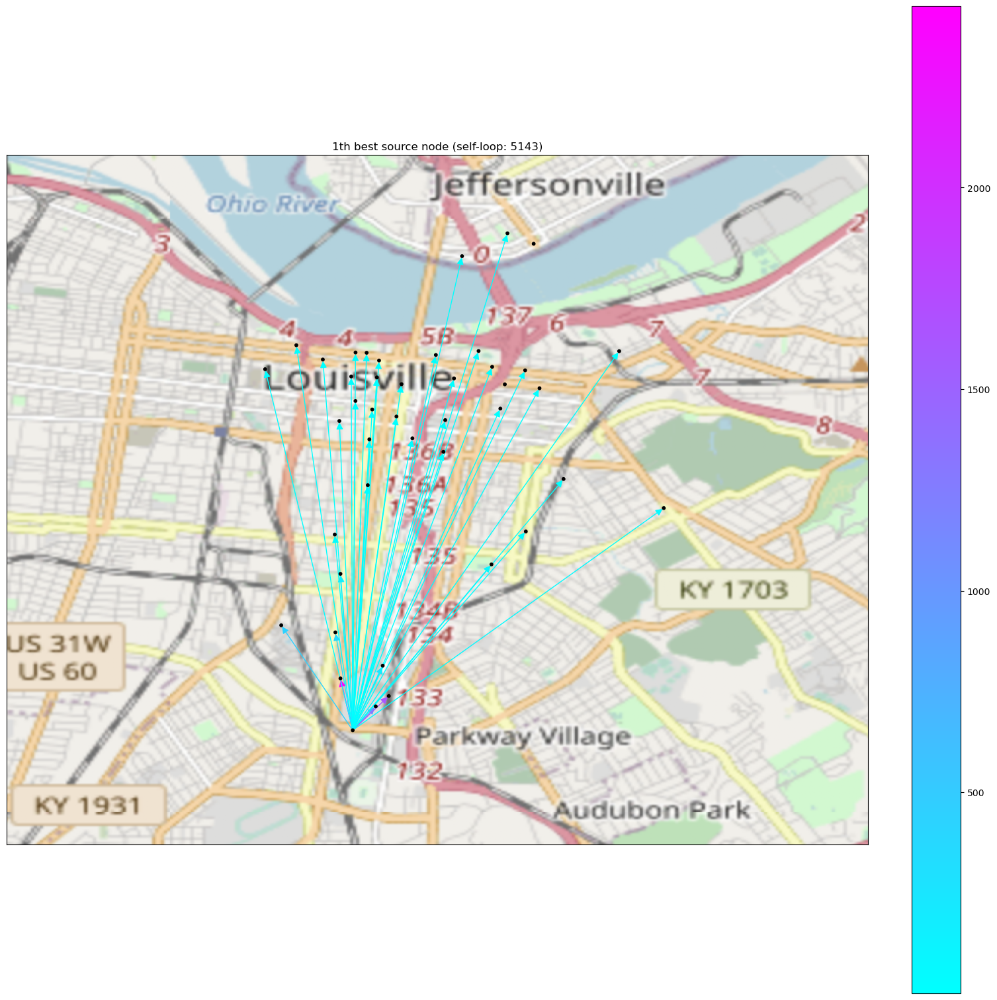

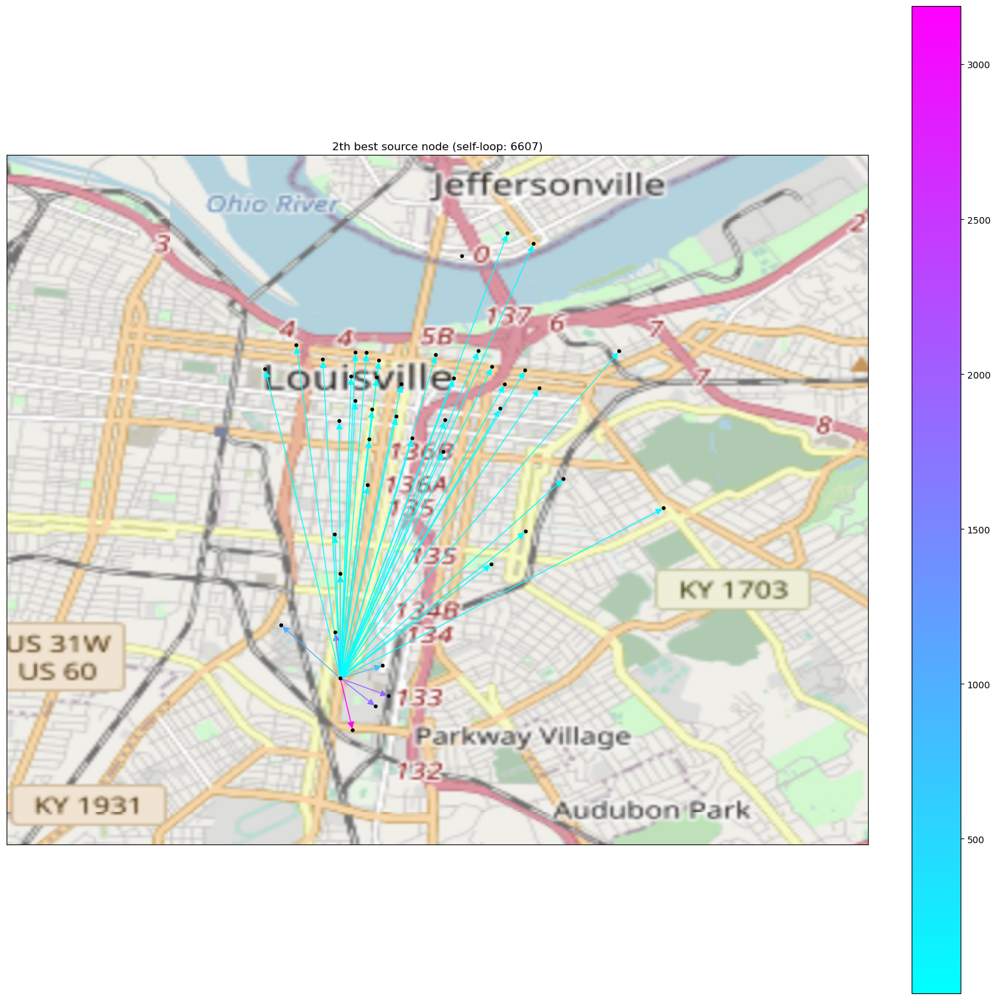

In [30]:
num_best_centroids = 2
self_loop = False

adj_matrix = centroid_adj_start.copy()
diag = np.diag(np.diag(adj_matrix))
if not self_loop:
    adj_matrix -= diag
best_idx = np.argpartition(np.sum(adj_matrix, axis=-1), -num_best_centroids)[-num_best_centroids:]

for i, centroid_idx in enumerate(best_idx):
    title = f"{i+1}th best source node (self-loop: {int(diag[centroid_idx, centroid_idx])})"
    draw_centroid_connections(centroid_idx, adj_matrix[centroid_idx], title=title)

We can have a look at the best sink nodes

/tmp/ipykernel_12666/1873449330.py:45: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  edges_drawn = nx.draw_networkx_edges(G, pos, edgelist=edges, arrowsize=15, node_size=node_size,
/tmp/ipykernel_12666/1873449330.py:53: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm)


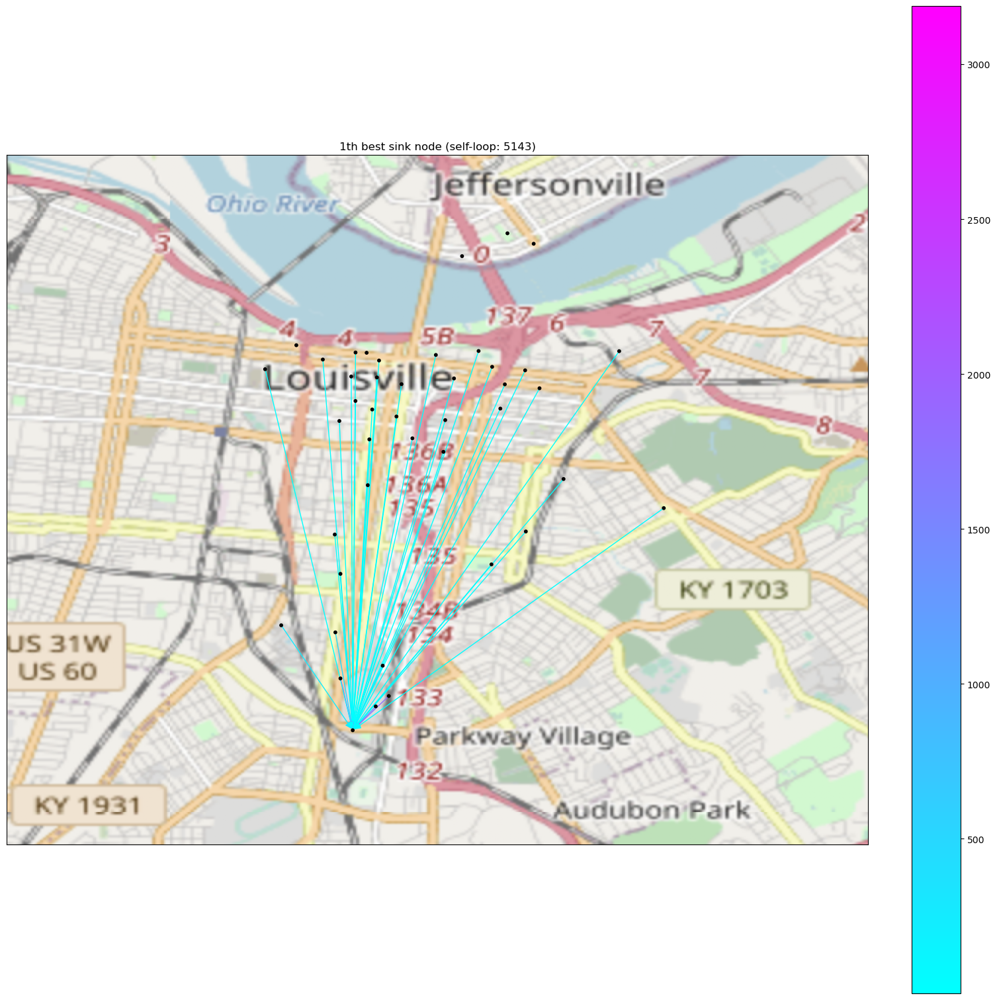

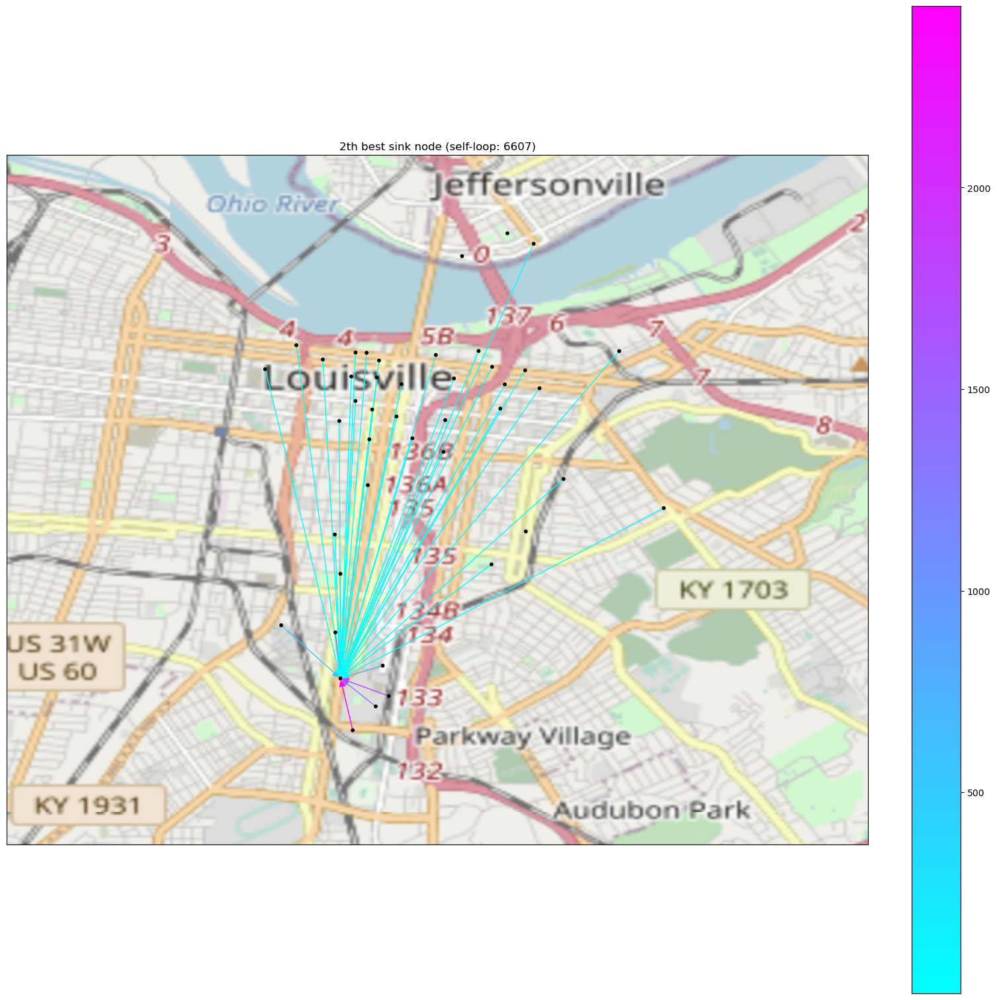

In [31]:
num_best_centroids = 2
self_loop = False

adj_matrix = centroid_adj_end.copy()
diag = np.diag(np.diag(adj_matrix))
if not self_loop:
    adj_matrix -= diag
best_idx = np.argpartition(np.sum(adj_matrix, axis=-1), -num_best_centroids)[-num_best_centroids:]

for i, centroid_idx in enumerate(best_idx):
    title = f"{i+1}th best sink node (self-loop: {int(diag[centroid_idx, centroid_idx])})"
    draw_centroid_connections(centroid_idx, adj_matrix[centroid_idx], title=title, from_to=False)

5. Factors/Locality over time 

In [32]:
timeshift = 2 #hours
if not (24/timeshift).is_integer():
      raise ValueError("Please enter a timeshift that divides the whole day for simplicity")
num_timeshifts = 24 // timeshift #simulate a day
time = 0
day = 9
month = 5
n_repeats = 1000

# list_adjacency_start = []
# list_adjacency_end = []

adjacency_start = np.zeros((num_timeshifts, num_centroids, num_centroids))
adjacency_end = np.zeros((num_timeshifts, num_centroids, num_centroids))

for k in range(n_repeats):

    day = np.random.randint(1, 28)
    month = np.random.randint(1, 12)
    time = 0

    for i in range(num_timeshifts):

        mask = (all_trips_data["Day"] == day) & (
            all_trips_data["Month"] == month
        )
        current_trips = all_trips_data[mask]

        # Keep only the trip at times we care:
        start_time = time
        end_time = time + timeshift

        time_mask = [
            float(time.replace(":", ".").split(".")[0]) >= start_time
            and float(time.replace(":", ".").split(".")[0]) <= end_time
            for time in current_trips["StartTime"].values
        ]

        current_trips = current_trips[time_mask]

        # adj_start = np.zeros((num_centroids, num_centroids))
        # adj_end = np.zeros((num_centroids, num_centroids))

        current_trips = current_trips.reset_index()  # make sure indexes pair with number of rows
        for index, trip in current_trips.iterrows():
            start_loc = np.array(
                [trip.StartLatitude, trip.StartLongitude]
            )
            # start_time = trip.iloc.StartTime

            distances = distance.cdist(
                start_loc.reshape(-1, 2), centroid_coords, metric="euclidean"
            )
            idx_start_centroid =  np.argmin(distances)

            end_loc = np.array(
            [trip.EndLatitude, trip.EndLongitude]
            )
            distances = distance.cdist(
                end_loc.reshape(-1, 2), centroid_coords, metric="euclidean"
            )
            idx_end_centroid = np.argmin(distances)

            #Compute adjacency
            adjacency_start[i, idx_start_centroid, idx_end_centroid] += 1
            adjacency_end[i, idx_end_centroid, idx_start_centroid] += 1

        # list_adjacency_start.append(adj_start)
        # list_adjacency_end.append(adj_end)

        time += timeshift
        if time > 24:
            raise ValueError("Simulation should be ending now")
        
adjacency_start /= n_repeats
adjacency_end /= n_repeats
        

/tmp/ipykernel_12666/3421202979.py:45: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  edges_drawn = nx.draw_networkx_edges(G, pos, edgelist=edges, arrowsize=15, node_size=node_size,
/tmp/ipykernel_12666/3421202979.py:53: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm)


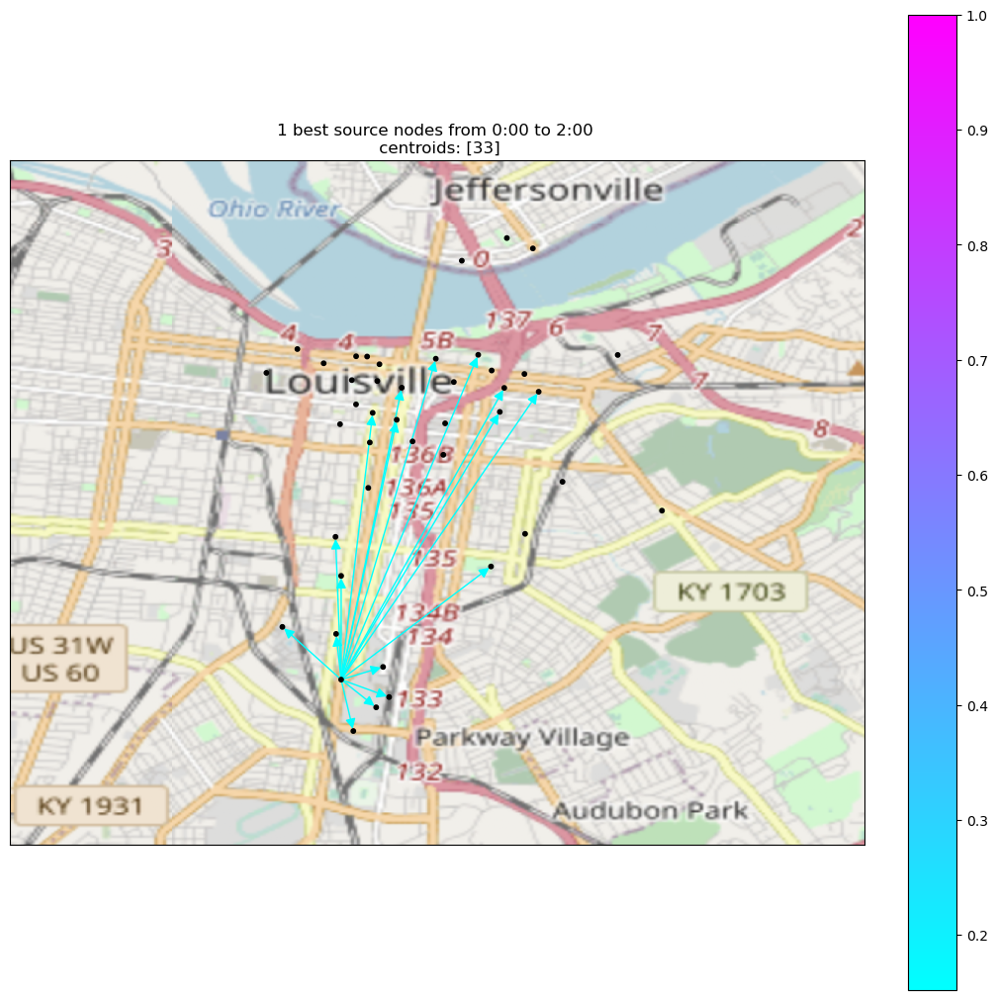

[33]


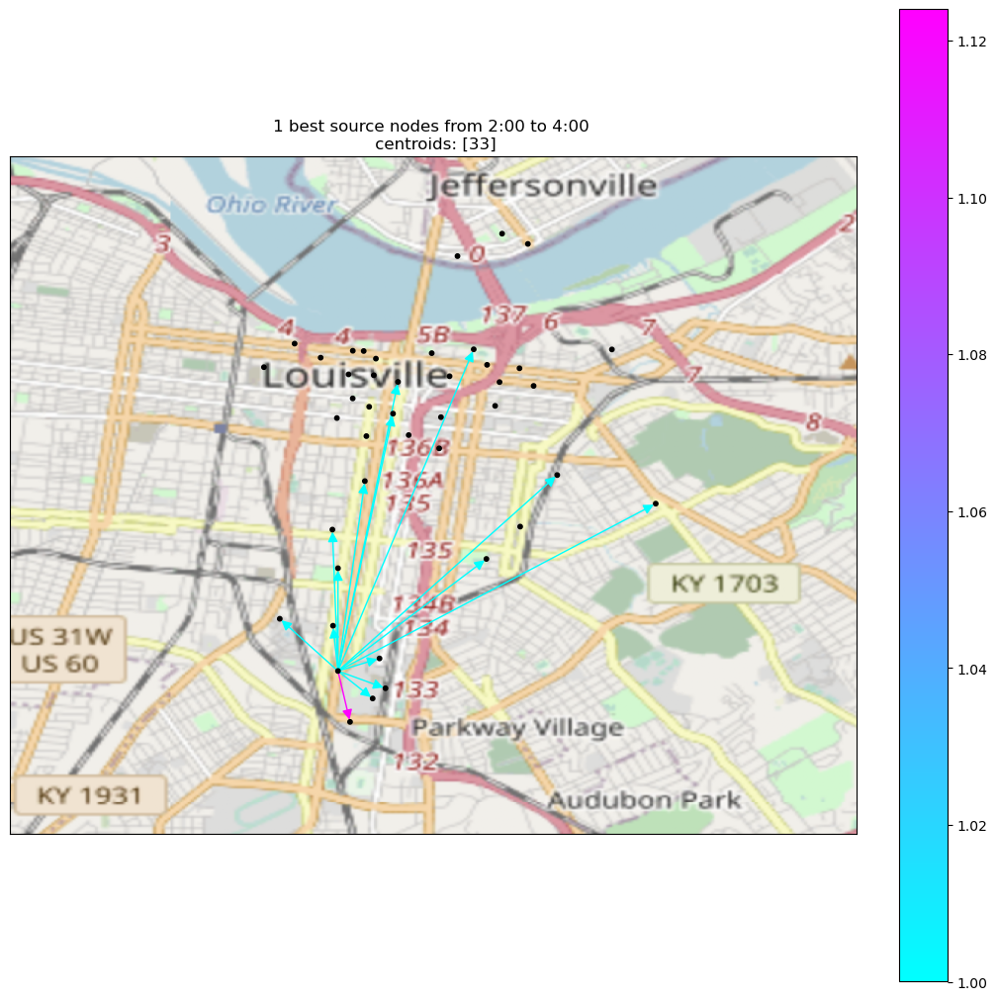

[33]


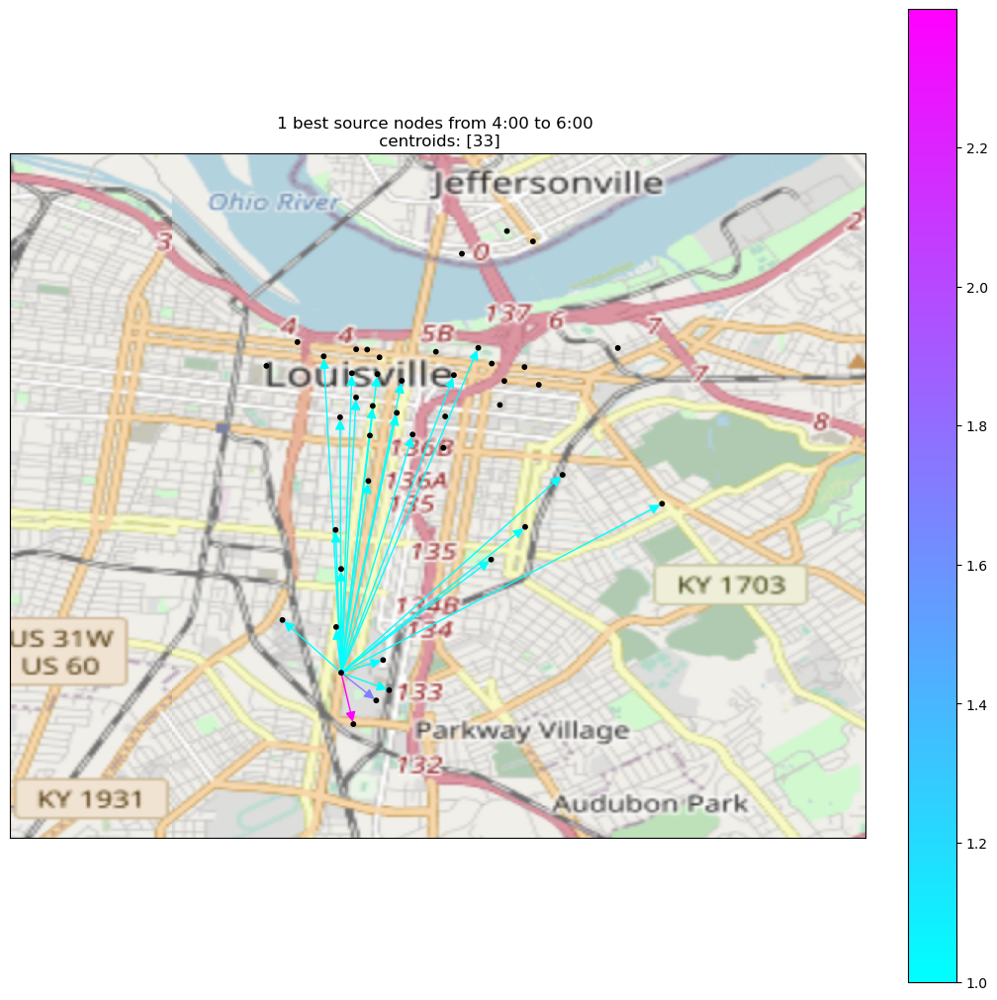

[33]


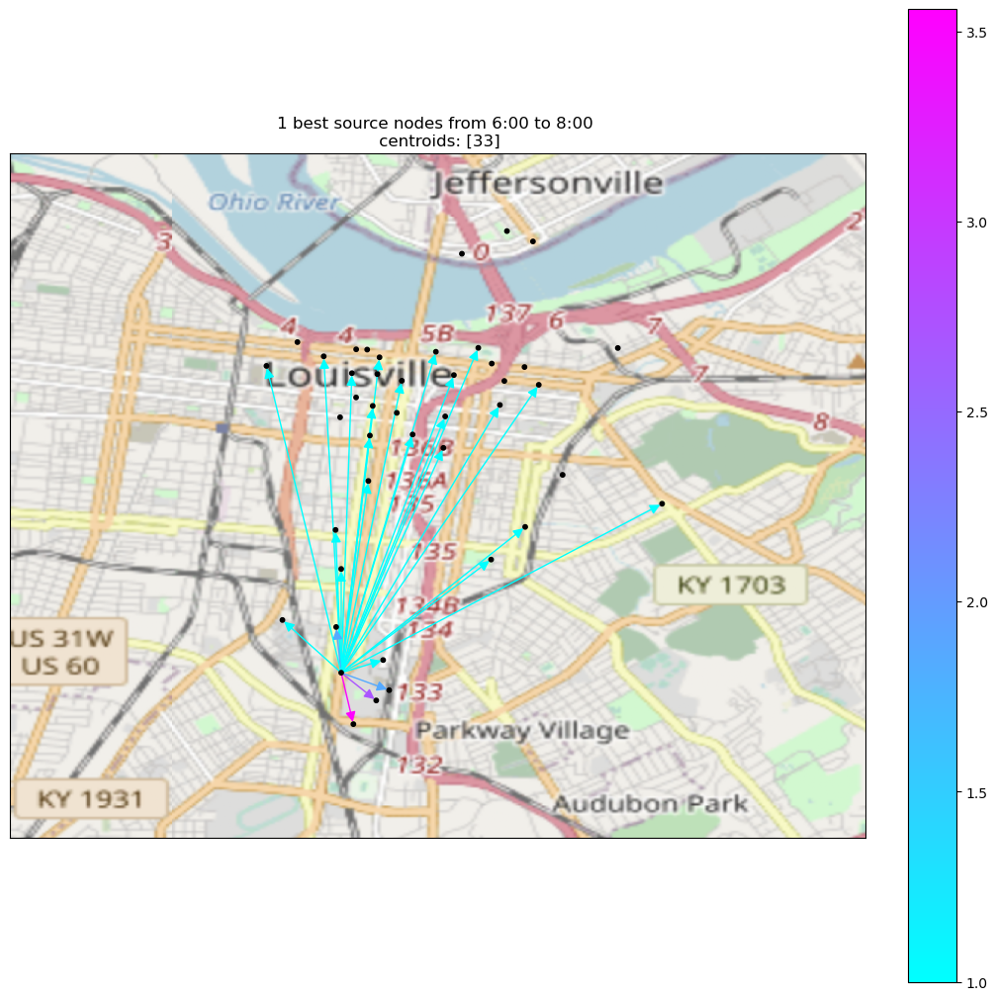

[33]


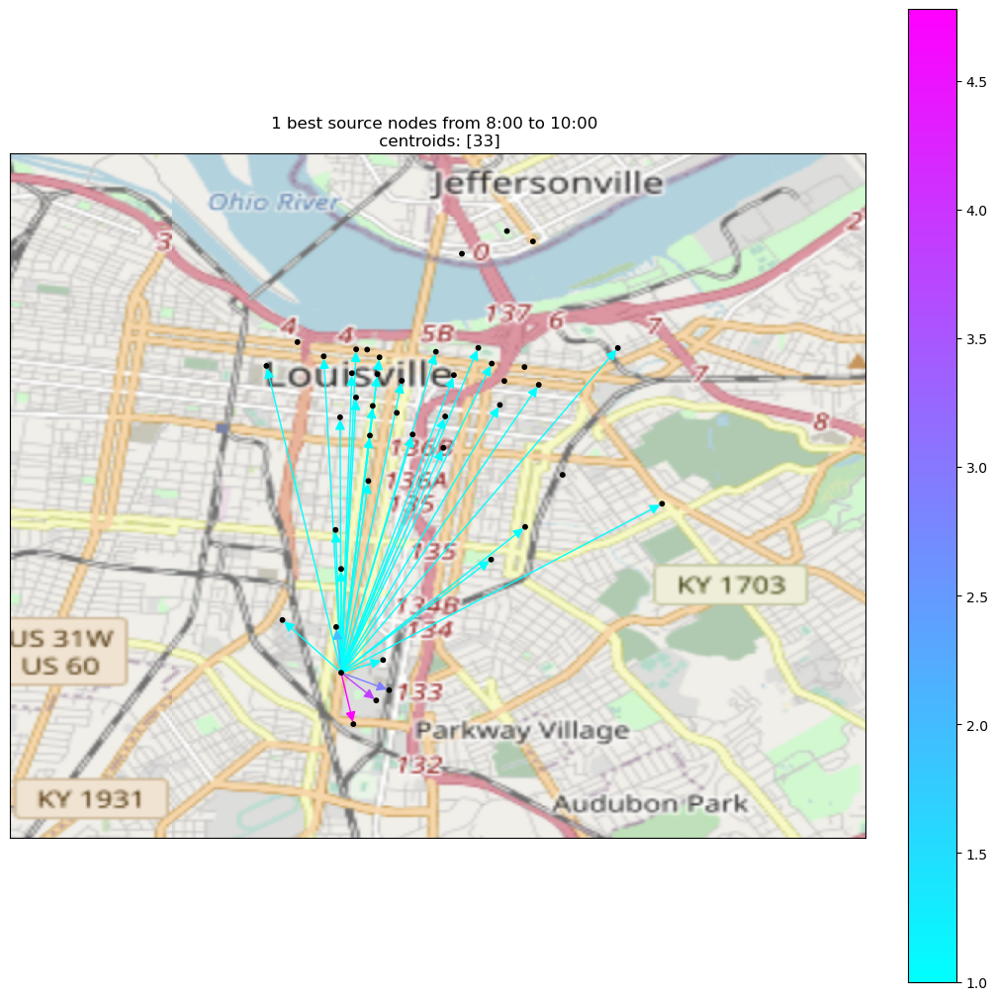

[33]


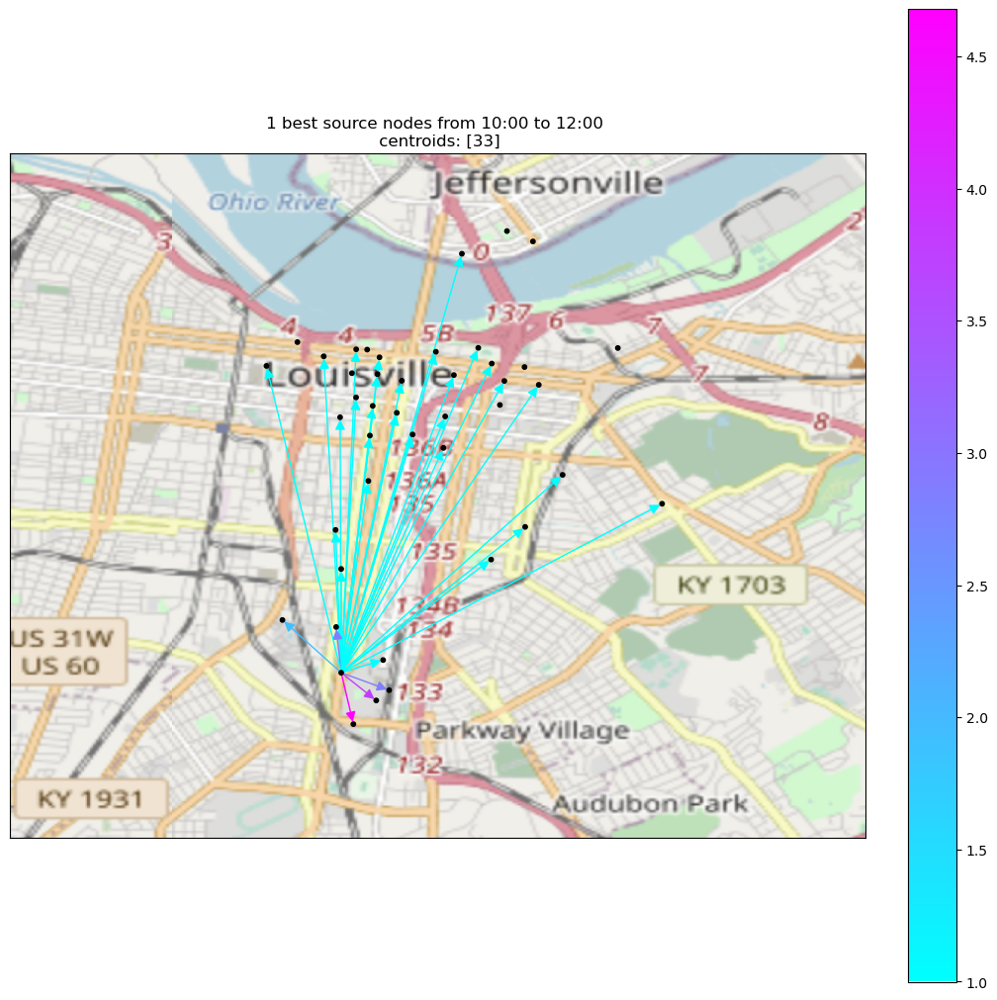

[33]


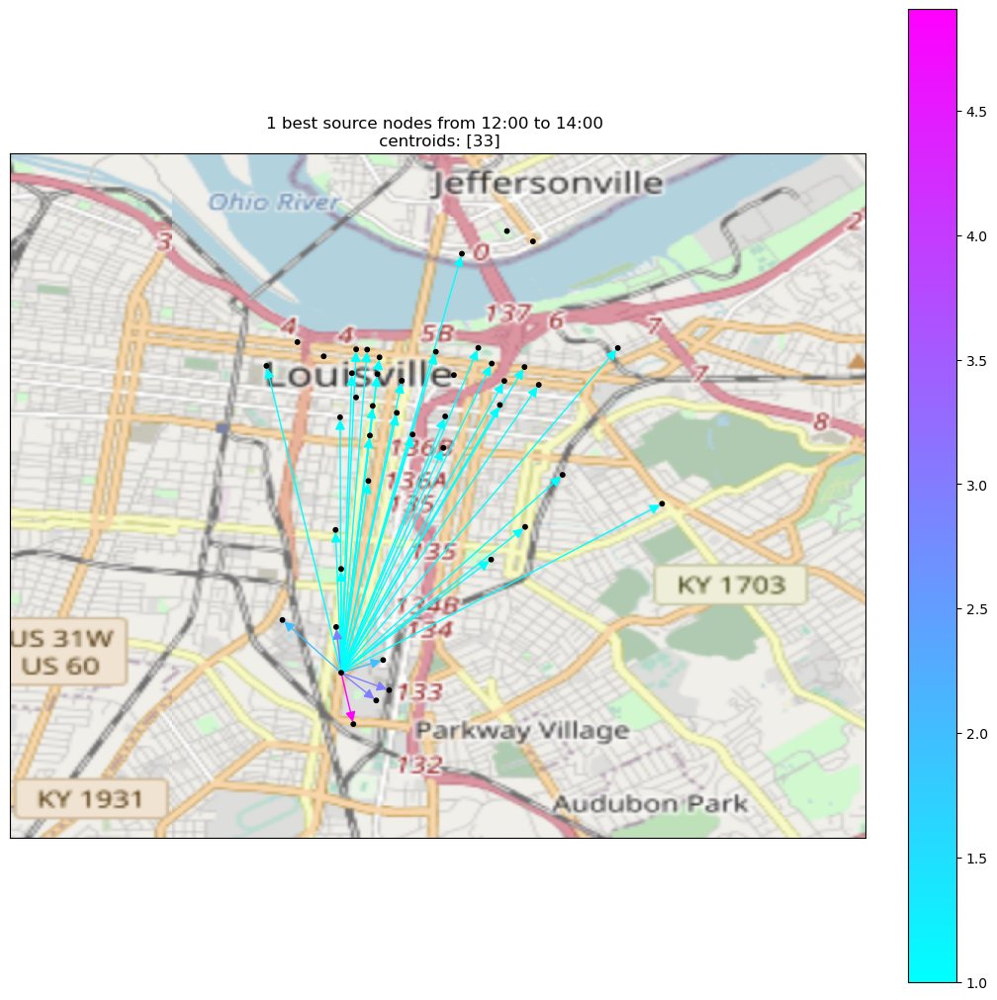

[33]


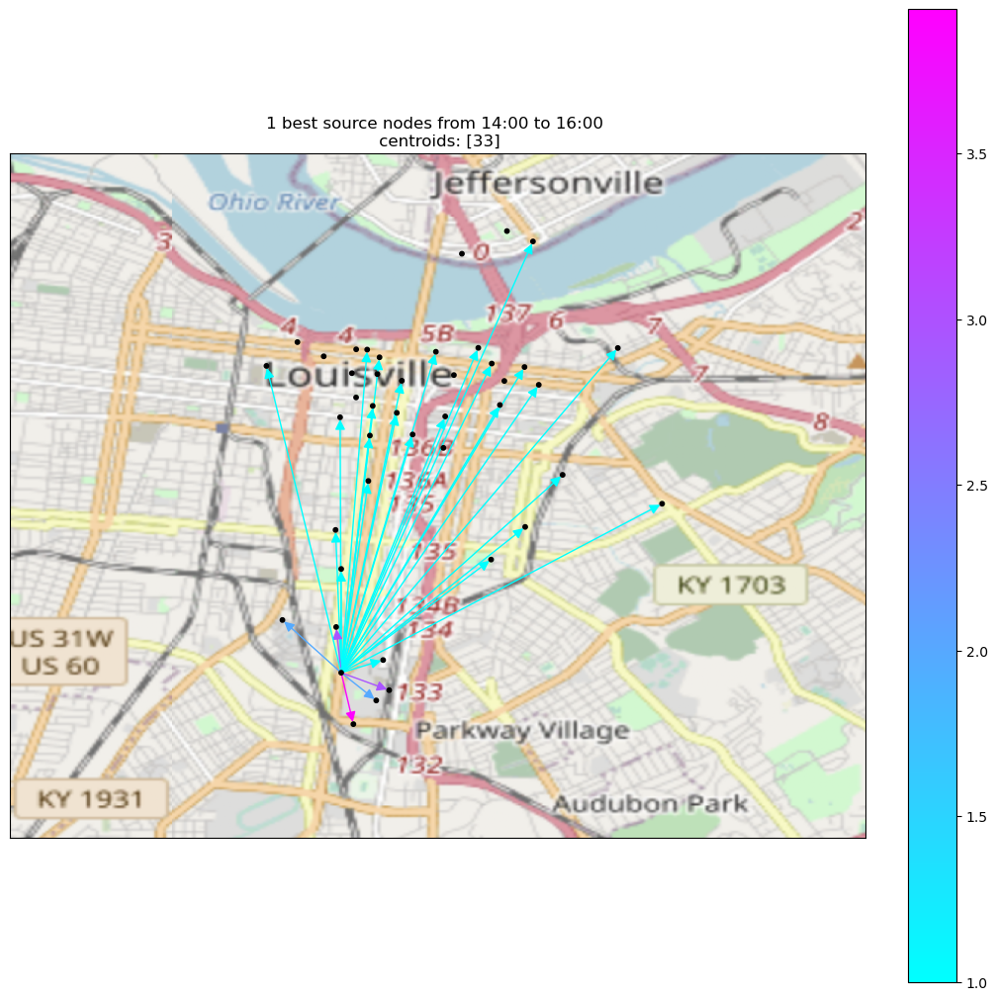

[33]


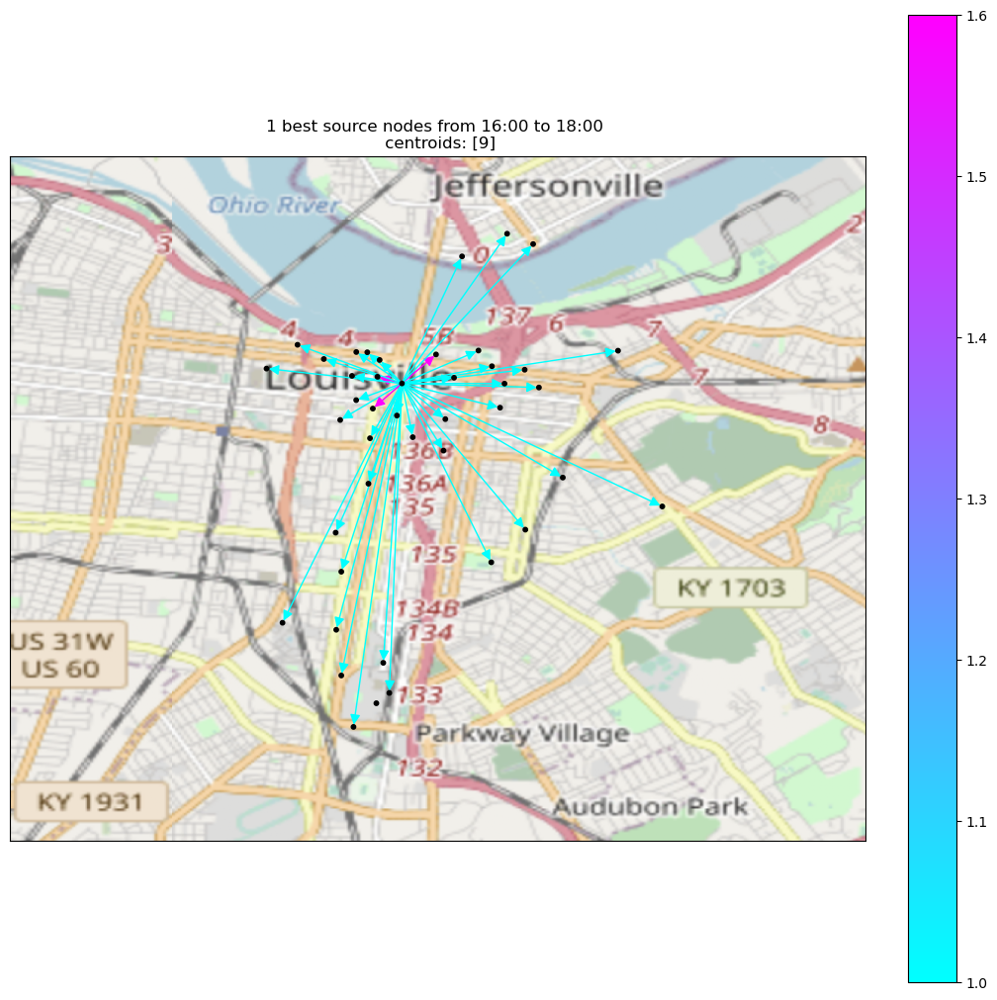

[9]


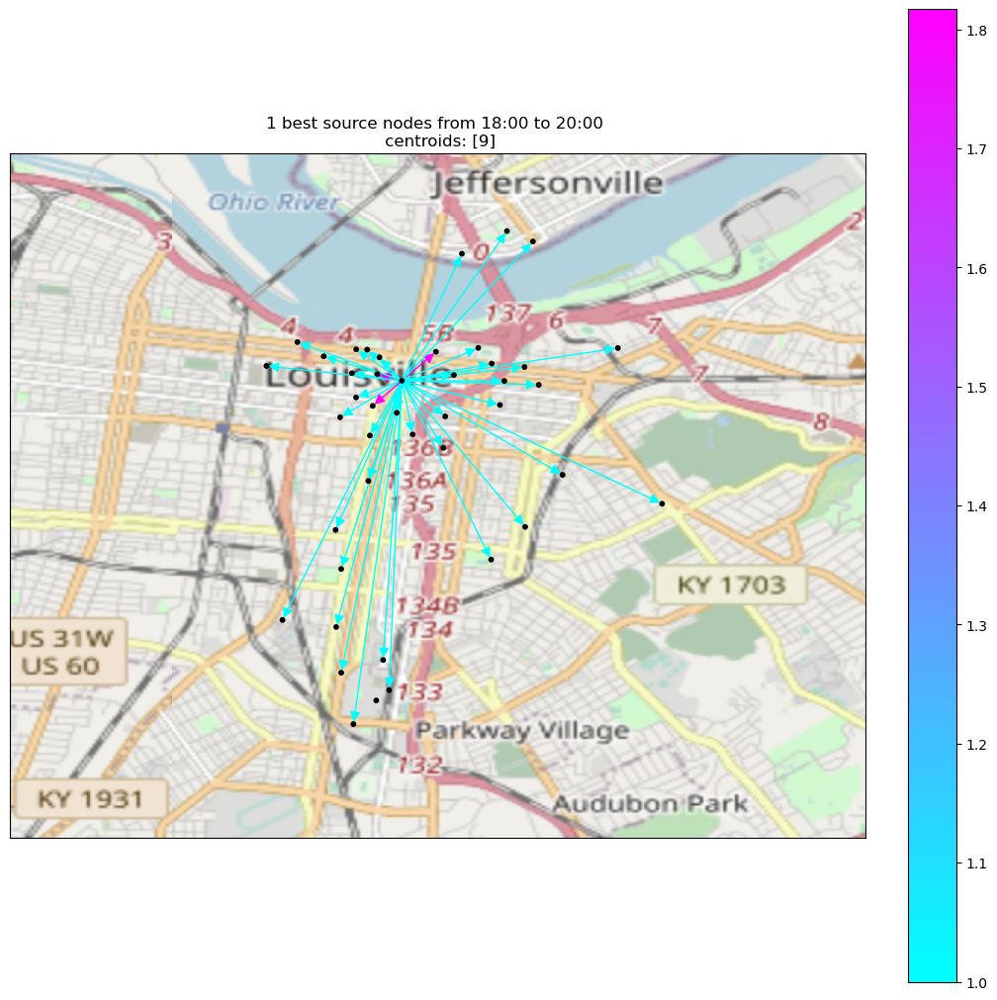

[9]


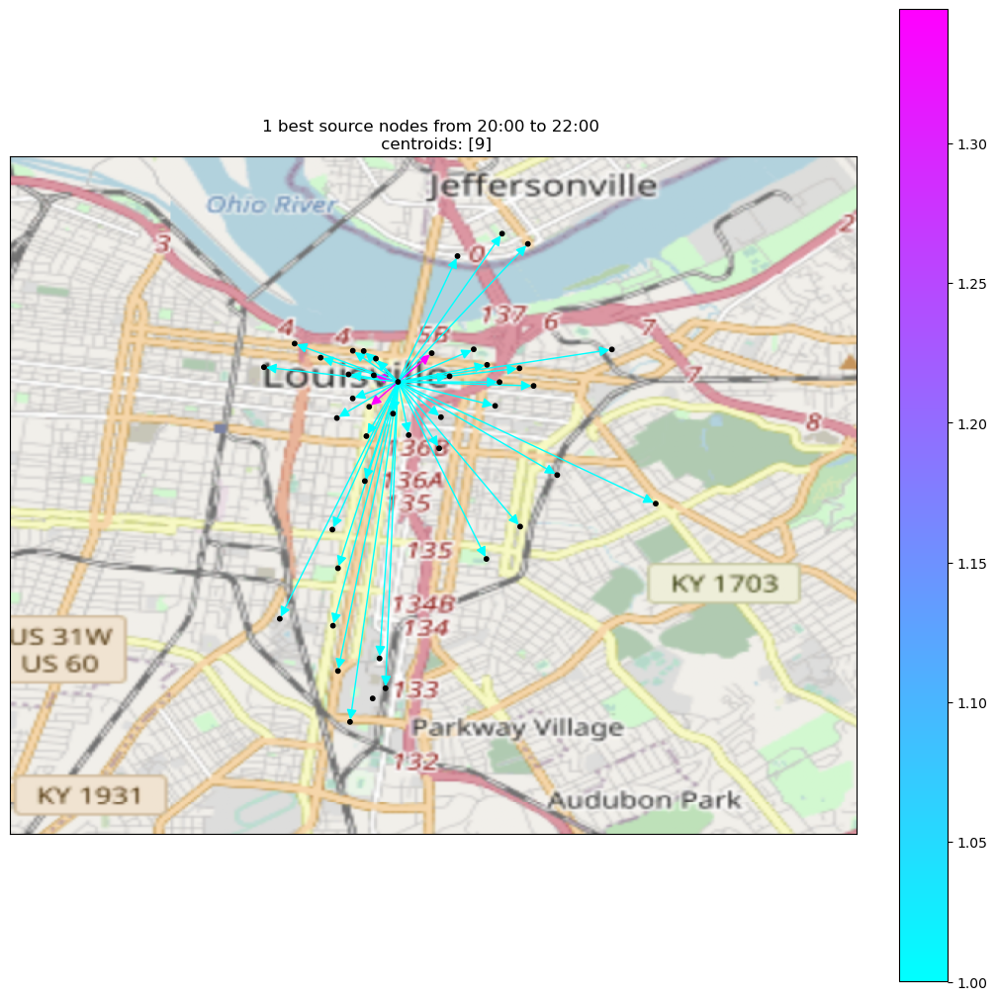

[9]


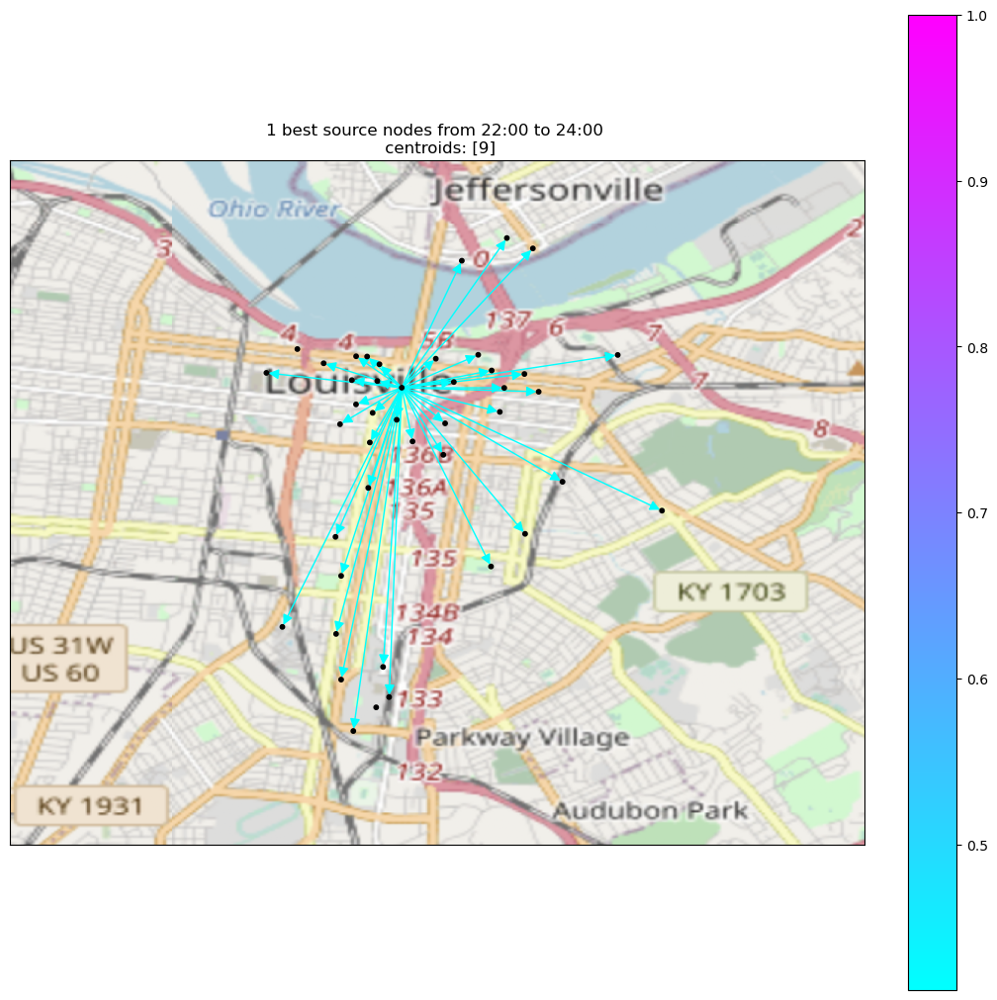

[9]


In [34]:
num_best_centroids = 1
self_loop = False
threshold = 0.

time = 0
for i, adj_start in enumerate(adjacency_start):
    adj_matrix = adj_start.copy()
    diag = np.diag(np.diag(adj_matrix))
    if not self_loop:
        adj_matrix -= diag
    if threshold > 0.:
        adj_matrix = np.where(adj_matrix <= threshold, 0., adj_matrix)
    best_idx = np.argpartition(np.sum(adj_matrix, axis=-1), -num_best_centroids)[-num_best_centroids:]
    title = f"{num_best_centroids} best source nodes from {time}:00 to {time+timeshift}:00 \n centroids: {best_idx}"
    draw_centroid_connections(best_idx, adj_matrix[best_idx], title=title)
    print(best_idx)
    
    time += timeshift

In [ ]:
num_best_centroids = 5
self_loop = False
threshold = 1.

time = 0
for i, adj_end in enumerate(adjacency_end):
    adj_matrix = adj_end.copy()
    diag = np.diag(np.diag(adj_matrix))
    if not self_loop:
        adj_matrix -= diag
    if threshold > 0.:
        adj_matrix = np.where(adj_matrix <= threshold, 0., adj_matrix)
    best_idx = np.argpartition(np.sum(adj_matrix, axis=-1), -num_best_centroids)[-num_best_centroids:]
    title = f"{num_best_centroids} best source nodes from {time}:00 to {time+timeshift}:00 \n centroids: {best_idx}"
    #draw_centroid_connections(range(num_centroids), adj_matrix, title=title, from_to=False)
    draw_centroid_connections(best_idx, adj_matrix[best_idx], title=title, from_to=False)
    
    time += timeshift

6. Most popular centroids over time

In [ ]:
def draw_centroids(centroid_sizes, title=None, from_to=True):
    G = nx.DiGraph()

    for i, (centroid_coord, centroid_size) in enumerate(zip(centroid_coords, centroid_sizes)):
        G.add_node(i, pos=np.flip(centroid_coord), color="c", weight=centroid_size)

    #Plot the map
    fig, ax = plt.subplots(layout="constrained", figsize=(15,15))
    city_map = plt.imread('src/env/bikes_data/louisville_map.png')
    ax.imshow(city_map, zorder=0, extent=[-85.9, -85.55, 38.15, 38.35], aspect='equal')
    ax.set_xlim(longitudes)
    ax.set_ylim(lattitudes)
    # title 
    if title is not None:
        ax.set_title(title)

    #Set up
    pos = nx.get_node_attributes(G, "pos")
    node_colors = nx.get_node_attributes(G, "color")
    node_weight = nx.get_node_attributes(G, "weight")

    #Nodes
    node_size = 10
    nx.draw_networkx(G, pos, with_labels=True, node_color=node_colors.values(), node_size=[100+value*1000 for value in node_weight.values()], ax=ax)
    return fig

a. Sink nodes

In [ ]:
self_loop = True
threshold = 0.
num_best_centroids = 10

time = 0
for i, adj_start in enumerate(adjacency_start):
    adj_matrix = adj_start.copy()
    if not self_loop:
        diag = np.diag(np.diag(adj_matrix))
        adj_matrix -= diag
    if threshold > 0.:
        adj_matrix = np.where(adj_matrix <= threshold, 0., adj_matrix)
    print(adj_matrix)
    best_idx = np.argpartition(np.sum(adj_matrix, axis=-1), -num_best_centroids)[-num_best_centroids:]
    title = f"Sink nodes score from {time}:00 to {time+timeshift}:00 \n best sinks: {best_idx}"
    draw_centroids(np.sum(adj_matrix, axis=0), title=title)
    
    time += timeshift

b. Source centroids

In [ ]:
num_best_centroids = 10
self_loop = True
threshold = 0.

time = 0
for i, adj_end in enumerate(adjacency_end):
    adj_matrix = adj_end.copy()
    if not self_loop:
        diag = np.diag(np.diag(adj_matrix))
        adj_matrix -= diag
    if threshold > 0.:
        adj_matrix = np.where(adj_matrix <= threshold, 0., adj_matrix)
    best_idx = np.argpartition(np.sum(adj_matrix, axis=-1), -num_best_centroids)[-num_best_centroids:]
    title = f"Source nodes score from {time}:00 to {time+timeshift}:00 \n best sources: {best_idx}"
    draw_centroids(np.sum(adj_matrix, axis=0), title=title)
    
    time += timeshift

7. Best centroids in function of the weather

In [ ]:
time = 0
day = 9
month = 5
n_days = 100
next_day = "sequential"
num_centroids = len(centroid_coords)

sources_centroids = np.zeros((n_days, num_centroids))
sinks_centroids = np.zeros((n_days, num_centroids))
temp_avg = np.empty((n_days,))
precipitation = np.empty((n_days,))
holidays = np.empty((n_days,))
days_of_week = np.empty((n_days,))

for k in range(n_days):

    mask = (all_trips_data["Day"] == day) & (
        all_trips_data["Month"] == month
    )
    current_trips = all_trips_data[mask]

    weather_mask = (all_weather_data["Day"] == day) & (
        all_weather_data["Month"] == month
    )
    next_index = np.where(mask)[0][-1]
    current_trips = all_trips_data[mask]
    weather = all_weather_data[weather_mask]
    temp_avg[k] = weather.Temp_Avg.to_numpy()[0]
    precipitation[k] = weather.Precip.to_numpy()[0]
    holidays[k] = weather.Holiday.to_numpy()[0]
    days_of_week = weather.DayOfWeek.to_numpy()[0]

    current_trips = current_trips.reset_index()  # make sure indexes pair with number of rows
    for index, trip in current_trips.iterrows():
        start_loc = np.array(
            [trip.StartLatitude, trip.StartLongitude]
        )

        distances = distance.cdist(
            start_loc.reshape(-1, 2), centroid_coords, metric="euclidean"
        )
        idx_start_centroid =  np.argmin(distances)

        end_loc = np.array(
        [trip.EndLatitude, trip.EndLongitude]
        )
        distances = distance.cdist(
            end_loc.reshape(-1, 2), centroid_coords, metric="euclidean"
        )
        idx_end_centroid = np.argmin(distances)

        #Compute adjacency
        sources_centroids[k, idx_start_centroid] += 1
        sinks_centroids[k, idx_end_centroid] += 1

    #Next day:
    if next_day == "random":
        day = np.random.randint(1, 28)
        month = np.random.randint(1, 12)
    elif next_day == "sequential":
        next_trip = all_trips_data.iloc[next_index+1]
        day = next_trip["Day"]
        month = next_trip["Month"]
    else:
        raise ValueError(f"No next_day incrementation called {next_day} implemented")
    

In [ ]:
num_best_centroids = 5

sources_count_diff = np.zeros((n_days,))
sinks_count_diff = np.zeros((n_days,))
ref_sink = np.array([84,98,99,56,6,87,80])
ref_source = np.array([84,99,98,56,87,6,80])
for day, (sources, sinks, holiday, precip, temp) in enumerate(zip(sources_centroids, sinks_centroids, holidays, precipitation, temp_avg)):
    best_source = np.sort(np.argpartition(sources, -num_best_centroids)[-num_best_centroids:])
    best_sink = np.sort(np.argpartition(sinks, -num_best_centroids)[-num_best_centroids:])

    if day == 0:
        ref_sink =best_sink
        ref_source = best_source
    
    for source, sink in zip(best_source, best_sink):
        if source not in ref_source[:num_best_centroids]:
            sources_count_diff[day] += 1
        if sink not in ref_sink[:num_best_centroids]:
            sinks_count_diff[day] += 1
    if day == 0 or sources_count_diff[day]>0 or sinks_count_diff[day]>0:
        print(f"Day: {day}")
        print(f"Best sources {best_source}")
        print(f"Best sinks {best_sink}")
        print(f"Holiday: {holiday}")
        print(f"Day of week: {days_of_week}")
        print(f"Precipitation: {precipitation}")
        print(f"Temperature: {temp}")

print(sources_count_diff)
print(sinks_count_diff)